<h1><b><pre>                    MUSIC GENRE CLASSIFIER</pre></b></h1>


<pre>
                              <img src="https://360digit.b-cdn.net/assets/admin/ckfinder/userfiles/images/blog/10-11-22/classification-of-music-genre-using-knn-1.PNG" alt="Music" />

</pre>


# **Introduction:**

The purpose of this report is to study the implementation of a machine learning model proficient in categorizing **music samples** into **distinct genres** based on the *characteristics* of the **audio signals**.The idea behind this project involves the utilization of **Python** for *the management of <b>sound files</b>*, *the extraction of key <b>audio features</b>*, *the application of <b>Machine Learning Algorithms</b>*, and the subsequent *analysis of results*.

Manual categorization of songs is a time-consuming task that this project aims to alleviate by implementing a model capable of swift genre identification through audio analysis. This automation not only saves time but also addresses the challenge of navigating through an extensive music catalog.

The model (Music Genre Classifier) is implemented using **Convolutional Neural Networks** (CNNs). Our dataset consists of audio samples, and preprocessing involves extracting **mel-frequency cepstral coefficients** (MFCCs), handling file formats, addressing noise, and ensuring uniform sample lengths.
The model is first trained on Training set and then tested over unseen Testing set and is evaluated using appropriate performance metrics such as **accuracy**, **precision**, **recall**, and **F1-score**.



# **Dataset: GTZAN Music Genre Dataset**
For this project, the dataset chosen for **Music Genre Classification** is the widely used ***GTZAN Music Genre Dataset***. Developed by *George Tzanetakis* and *Perry Cook* at the *University of Victoria*, this dataset stands as a benchmark in the field of music genre classification.

 ## **Dataset Source:**  
 The GTZAN Music Genre Dataset was obtained from Kaggle (URL:   https://www.kaggle.com/datasets/carlthome/gtzan-genre-collection ) and downloaded directly to the Google Drive using the Kaggle API.


Following is the code to **download** the dataset from kaggle to the default google drive directory:


* Note:
   * First  create **Kaggle API token.**
   * File named **kaggle.json** will be downloaded.
   * Create a new folder in Google Drive (e.g. kaggle) and **upload the file** to that folder.
   * **Mount** Google Drive to the Colab notebook


```
                   from google.colab import drive
                   drive.mount('/content/drive')

```

  * Set Kaggle configuration path to **kaggle.json**


```
                   import os
                   os.environ['KAGGLE_CONFIG_DIR'] = "/content/drive/MyDrive/kaggle"
```




   * Change the current working directory to /kaggle folder



```
                    %cd /content/drive/MyDrive/kaggle/
```


   * Download the dataset using API Command

```
                   !kaggle datasets download -d carlthome/gtzan-genre-collection --unzip
```






 ## **Key Features of GTZAN Dataset:**

* **Genre Diversity:** The dataset spans across ten distinct genres, providing a comprehensive representation of musical styles. Genres include:
     * Rock
     * Jazz
     * Pop
     * Hip-hop
     * Blues
     * Classical
     * Reggae
     * Country
     * Metal
     * Disco
     
* **Audio Samples:** Each genre comprises 100 audio samples, resulting in a total of 1000 audio tracks in the dataset. These samples are relatively short clips, lasting around 30 seconds each.

* **Format and Quality:** Audio files in the dataset are typically in the AU format, ensuring a high-quality representation of the musical content.

* **Annotated Labels:** Each audio track comes with an annotated genre label, facilitating supervised learning for machine learning models.






In [ ]:
# connecting the notebook with google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# changing the present working directory
%cd /content/drive/MyDrive/kaggle/

/content/drive/MyDrive/kaggle


In [ ]:
# Path to the GTZAN dataset
dataset_path = 'genres/'

In [ ]:
!pip install tensorflow

## **Importing the Necessary Libraries**

In [ ]:
import os
import IPython.display as ipd
from IPython.display import Audio, display
import random
import librosa

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Conv1D, MaxPooling1D



In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import shuffle
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, confusion_matrix , recall_score




# **Data Preprocessing and Cleaning:**

## <b>Loading DataSet:</b>

In [ ]:

# Function to load audio dataset
def load_audio_dataset(dataset_path):
    classes = []
    audio_data = []

    # Iterate through each subdirectory (class) in the dataset
    for class_name in os.listdir(dataset_path):
        class_path = os.path.join(dataset_path, class_name)

        # Check if it's a directory
        if os.path.isdir(class_path):
            classes.append(class_name)

            # Initialize a list to store audio files for each class
            class_audio = []

            # Iterate through each audio file in the class
            for audio_file in os.listdir(class_path):
                audio_file_path = os.path.join(class_path, audio_file)

                # Load audio using librosa
                y, sr = librosa.load(audio_file_path, sr=None)

                # Append audio data to the class_audio list
                class_audio.append({
                    'file_name': audio_file,
                    'audio_data': y,
                    'duration': librosa.get_duration(y=y, sr=sr),
                    'sample_rate': sr
                })

            # Append class_audio to the audio_data list
            audio_data.append(class_audio)

    return classes, audio_data

# Call the function to load the dataset
classes, audio_data = load_audio_dataset(dataset_path)

# Print the classes and audio information
for i, class_name in enumerate(classes):
    print(f"Class {i + 1}: {class_name}")
    print(f"Number of audios: {len(audio_data[i])}")
    print("Sample audio information:")
    print(audio_data[i][0])  # Print information of the first audio in each class
    print("_____________________________________________________________________________________________________\n")


Class 1: blues
Number of audios: 100
Sample audio information:
{'file_name': 'blues.00000.au', 'audio_data': array([ 0.00732422,  0.01660156,  0.00762939, ..., -0.05560303,
       -0.06106567, -0.06417847], dtype=float32), 'duration': 30.013333333333332, 'sample_rate': 22050}
_____________________________________________________________________________________________________

Class 2: classical
Number of audios: 100
Sample audio information:
{'file_name': 'classical.00000.au', 'audio_data': array([-0.02008057, -0.01748657,  0.00418091, ...,  0.01934814,
        0.027771  ,  0.03131104], dtype=float32), 'duration': 30.013333333333332, 'sample_rate': 22050}
_____________________________________________________________________________________________________

Class 3: country
Number of audios: 100
Sample audio information:
{'file_name': 'country.00000.au', 'audio_data': array([-0.13415527, -0.19485474, -0.04257202, ...,  0.2260437 ,
        0.15042114,  0.04238892], dtype=float32), 'dura

## **Playing a Random Audio file from each Class**

In [ ]:


# Function to play a random audio file from each class
def play_random_audio(classes, audio_data):
    for i, class_name in enumerate(classes):
        print(f"Playing a random audio from Class {i + 1}: {class_name}")

        # Get a random index to select a random audio file
        random_index = random.randint(0, len(audio_data[i]) - 1)
        random_audio = audio_data[i][random_index]

        # Display audio information
        print(f"Audio File: {random_audio['file_name']}")
        print(f"Duration: {random_audio['duration']} seconds")
        print(f"Sample Rate: {random_audio['sample_rate']} Hz")

        # Play the audio using ipd.Audio
        ipd.display(ipd.Audio(random_audio['audio_data'], rate=random_audio['sample_rate']))

        print("_____________________________________________________________________________________________________\n")


# Call the function to play random audio from each class
play_random_audio(classes, audio_data)

Playing a random audio from Class 1: blues
Audio File: blues.00086.au
Duration: 30.013333333333332 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 2: classical
Audio File: classical.00017.au
Duration: 30.013333333333332 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 3: country
Audio File: country.00004.au
Duration: 29.995827664399094 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 4: disco
Audio File: disco.00067.au
Duration: 30.00018140589569 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 5: hiphop
Audio File: hiphop.00080.au
Duration: 30.00018140589569 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 6: jazz
Audio File: jazz.00062.au
Duration: 30.013333333333332 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 7: metal
Audio File: metal.00078.au
Duration: 30.00018140589569 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 8: pop
Audio File: pop.00055.au
Duration: 30.00018140589569 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 9: reggae
Audio File: reggae.00080.au
Duration: 30.00018140589569 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________

Playing a random audio from Class 10: rock
Audio File: rock.00006.au
Duration: 30.013333333333332 seconds
Sample Rate: 22050 Hz


_____________________________________________________________________________________________________



## <b>Normalization:</b>
<b>*Normalization*</b> refers to the process of <b>*Scaling*</b> and <b>*Transforming*</b> input features to ensure that they have a similar scale and distribution.

The goal is to bring all the features to a similar scale, usually between 0 and 1, or within a specific range, to ensure that no single feature dominates the learning process. Audio signals vary widely in <b>*Amplitude*</b>,  normalization helps in making the data more manageable and prevents certain features from overshadowing others during the learning process.

In [ ]:
# Normalization

# Function to normalize audio data
def normalize_audio(audio_data):
    normalized_audio_data = []

    for class_audio in audio_data:
        normalized_class_audio = []

        for audio_info in class_audio:
            y = audio_info['audio_data']

            # Normalize the audio by scaling amplitude
            normalized_y = (y - np.mean(y)) / np.std(y)

            # Append normalized audio data to the normalized_class_audio list
            normalized_class_audio.append({
                'file_name': audio_info['file_name'],
                'normalized_audio': normalized_y,
                'duration': audio_info['duration'],
                'sample_rate': audio_info['sample_rate']
            })

        # Append normalized_class_audio to the normalized_audio_data list
        normalized_audio_data.append(normalized_class_audio)

    return normalized_audio_data

# Call the function to normalize the audio data
normalized_audio_data = normalize_audio(audio_data)

# Print the normalized audio information
for i, class_name in enumerate(classes):
    print(f"Class {i + 1}: {class_name}")
    print(f"Number of audios: {len(normalized_audio_data[i])}")
    print("Sample normalized audio information:")
    print(normalized_audio_data[i][0])  # Print information of the first normalized audio in each class
    print("_______________________________________________________________________________________\n")



Class 1: blues
Number of audios: 100
Sample normalized audio information:
{'file_name': 'blues.00000.au', 'normalized_audio': array([ 0.05248408,  0.11842656,  0.05465324, ..., -0.3947968 ,
       -0.43362474, -0.4557502 ], dtype=float32), 'duration': 30.013333333333332, 'sample_rate': 22050}
_______________________________________________________________________________________

Class 2: classical
Number of audios: 100
Sample normalized audio information:
{'file_name': 'classical.00000.au', 'normalized_audio': array([-0.5082877 , -0.44207108,  0.11103268, ...,  0.49820527,
        0.71321464,  0.8035809 ], dtype=float32), 'duration': 30.013333333333332, 'sample_rate': 22050}
_______________________________________________________________________________________

Class 3: country
Number of audios: 100
Sample normalized audio information:
{'file_name': 'country.00000.au', 'normalized_audio': array([-0.53157705, -0.77453434, -0.1650035 , ...,  0.9101649 ,
        0.60747606,  0.1750634 ]

In [ ]:

# Assume you want to listen to the first normalized audio in the first class
sample_normalized_audio = normalized_audio_data[0][1]['normalized_audio']
sample_sample_rate = normalized_audio_data[0][1]['sample_rate']


# Play the normalized audio
ipd.Audio(sample_normalized_audio, rate=sample_sample_rate)


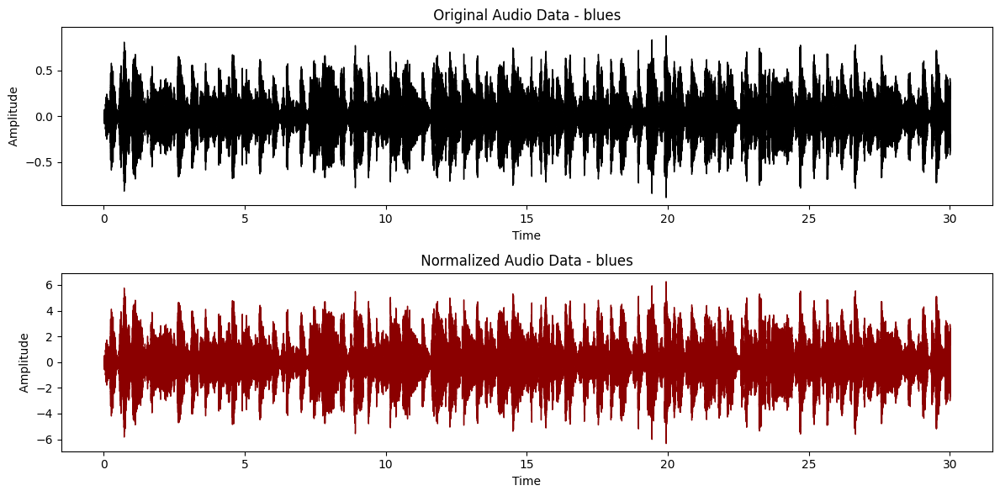

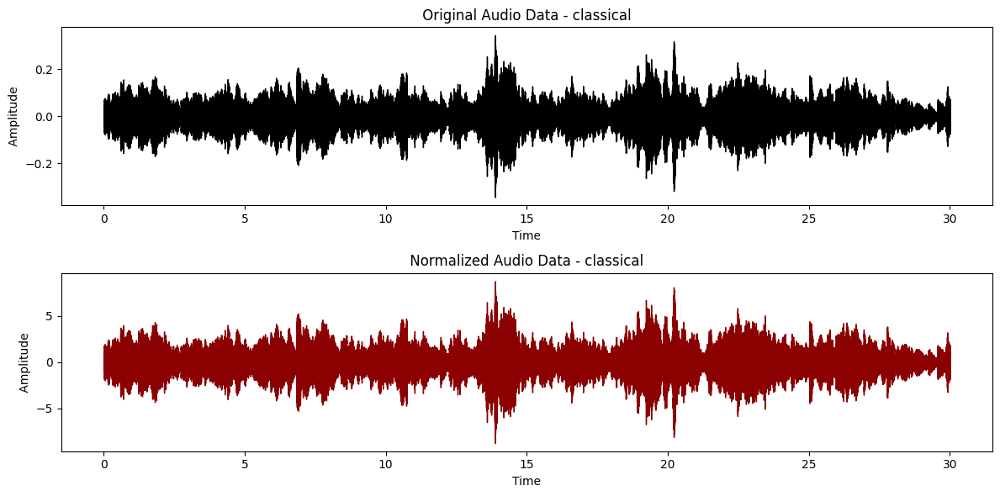

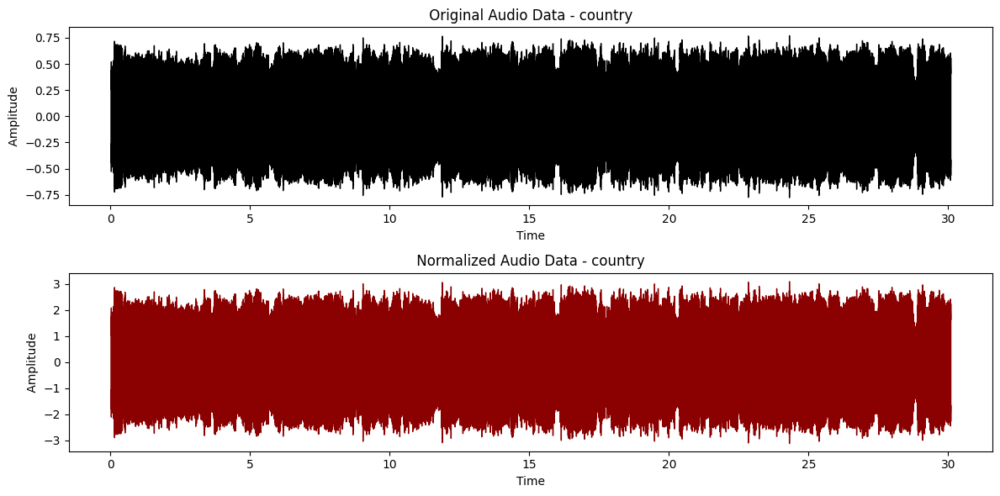

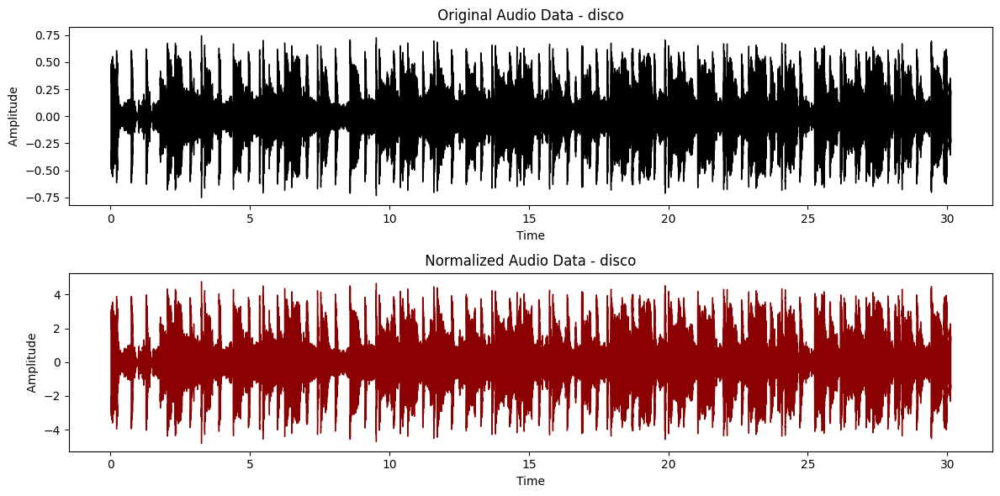

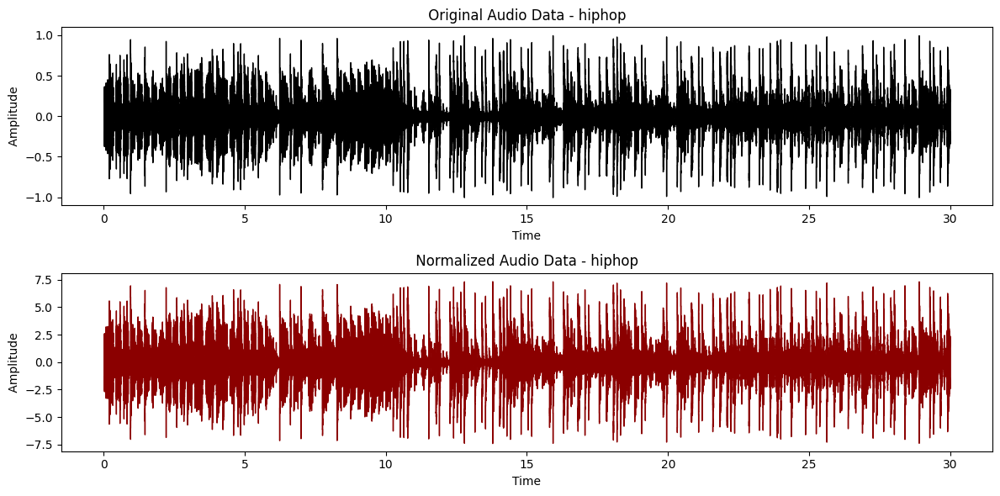

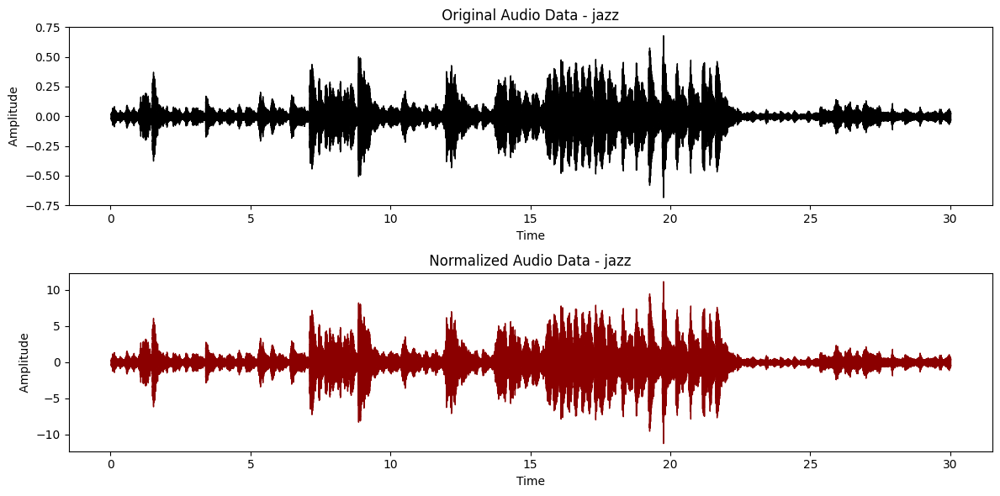

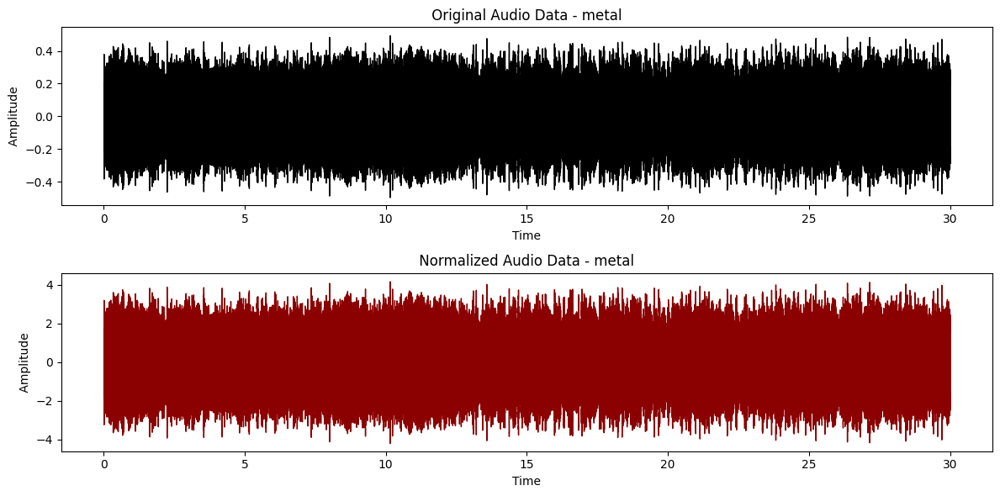

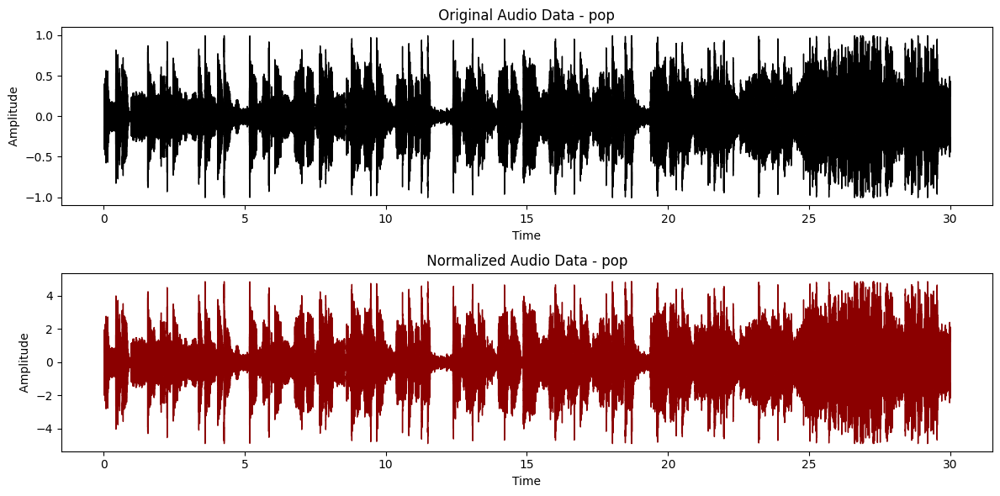

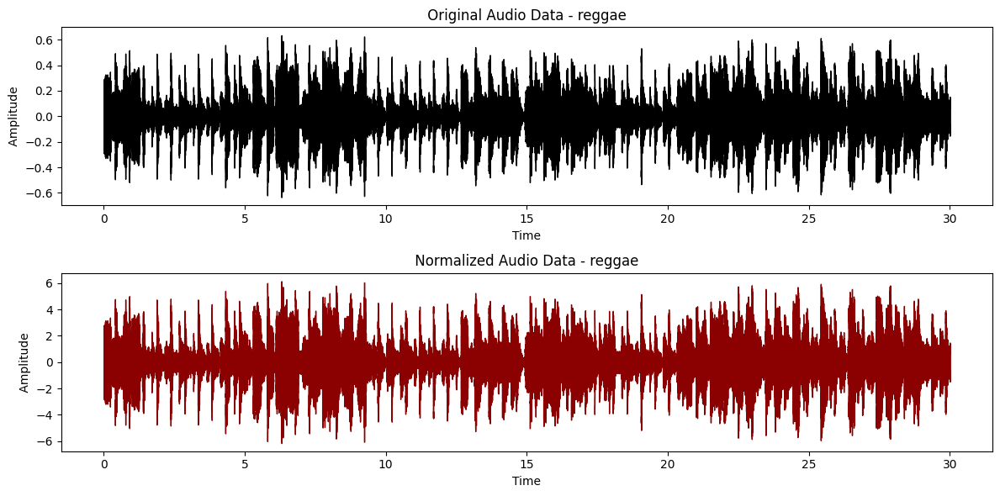

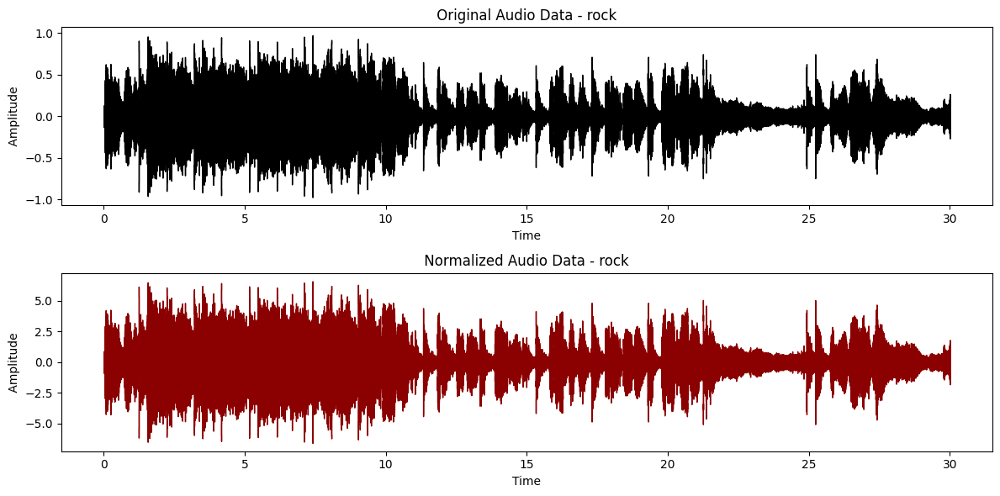

In [ ]:
# Function to plot original and normalized audio waveforms
def plot_audio_waveforms(original_audio, normalized_audio, sample_rate, title):
    plt.figure(figsize=(12, 6))

    # Plot original audio waveform
    plt.subplot(2, 1, 1)
    librosa.display.waveshow(original_audio, sr=sample_rate,color='black')
    plt.title(f" Original Audio Data - {title} ")
    plt.ylabel(" Amplitude ")

    # Plot normalized audio waveform
    plt.subplot(2, 1, 2)
    librosa.display.waveshow(normalized_audio, sr=sample_rate,color='darkred')
    plt.title(f" Normalized Audio Data - {title} ")
    plt.ylabel(" Amplitude ")

    plt.tight_layout()
    plt.show()

# Plot the first audio file from each class
for i, class_name in enumerate(classes):
    original_audio = audio_data[i][0]['audio_data']
    normalized_audio = normalized_audio_data[i][0]['normalized_audio']
    sample_rate = audio_data[i][0]['sample_rate']
    plot_audio_waveforms(original_audio, normalized_audio, sample_rate, class_name)


## <b>Trimming:</b>
<b>*Trimming*</b> refers to the process of removing <b>*Unnecessary or Silent*</b> portions from audio recordings. The goal of trimming is to focus on the relevant parts of the audio signals and eliminate any quiet periods or background noise that may not contribute significantly to the learning task.

In [ ]:
# Trimming
import librosa.effects

# Function to check if trimming is needed on normalized audio data
def check_trim_need(normalized_audio_data, energy_threshold=0.001, duration_threshold=2.0):
    needs_trim = []

    for class_audio in normalized_audio_data:
        for audio_info in class_audio:
            normalized_y = audio_info['normalized_audio']

            # Calculate energy of the normalized audio
            energy = np.sum(normalized_y ** 2)

            # Check if the energy is below the threshold or duration is below the threshold
            if energy < energy_threshold or audio_info['duration'] < duration_threshold:
                needs_trim.append({
                    'file_name': audio_info['file_name'],
                    'energy': energy,
                    'duration': audio_info['duration'],
                    'sample_rate': audio_info['sample_rate']
                })

    return needs_trim

# Call the function to check if trimming is needed on normalized audio data
trimming_needed_info = check_trim_need(normalized_audio_data)

# Print information about normalized audio files that may need trimming
if trimming_needed_info:
    print("Normalized audio files that may need trimming:")
    for info in trimming_needed_info:
        print(f"File: {info['file_name']}, Energy: {info['energy']}, Duration: {info['duration']} seconds, Sample Rate: {info['sample_rate']}")
else:
    print(" --------------------  No trimming needed for any normalized audio files. --------------------")





 --------------------  No trimming needed for any normalized audio files. --------------------


## <b>Padding:</b>
<b>*Padding*</b> refers to the process of adding extra <b>*Elements*</b> to the beginning or end of a sequence. The purpose of padding is to ensure that all sequences in a dataset have the <b>*same Length*</b>. Padding is often used when the <b>*duration of audio recordings varies*</b>, and learning models expect input data of uniform length.

In [ ]:
# Padding

def pad_normalized_audio(normalized_audio_data, target_duration=29.0):
    padded_normalized_audio_data = []

    for class_audio in normalized_audio_data:
        padded_class_audio = []

        for audio_info in class_audio:
            duration = audio_info['duration']
            normalized_y = audio_info['normalized_audio']
            sample_rate = audio_info['sample_rate']

            # Pad the normalized audio to the target duration
            padding_length = int((target_duration - duration) * sample_rate)

            # Ensure that padding length is non-negative
            padding_length = max(0, padding_length)

            padded_normalized_y = np.pad(normalized_y, (0, padding_length), 'constant', constant_values=(0, 0))
            duration = target_duration  # Update duration after padding

            padded_class_audio.append({
                'file_name': audio_info['file_name'],
                'normalized_audio': padded_normalized_y,
                'duration': duration,
                'sample_rate': sample_rate
            })

        padded_normalized_audio_data.append(padded_class_audio)

    return padded_normalized_audio_data

# Assume normalized_audio_data contains 29s and 30s normalized audio
# Call the function to pad all normalized audio to 29 seconds
normalized_audio_data_after_padding = pad_normalized_audio(normalized_audio_data, target_duration=29.0)

# Print information about normalized audio files after padding
print("\nNormalized audio files after padding: ")

for class_audio in normalized_audio_data_after_padding:
    for audio_info in class_audio:
        print(f"File: {audio_info['file_name']}, Duration: {audio_info['duration']} seconds, Sample Rate: {audio_info['sample_rate']}")



Normalized audio files after padding: 
File: blues.00000.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00001.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00002.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00003.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00004.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00005.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00006.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00007.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00008.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00009.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00010.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00011.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00012.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00013.au, Duration: 29.0 seconds, Sample Rate: 22050
File: blues.00014.au, Duration: 29.0 seconds, Samp

## **Resampling:**
<b>*Resampling*</b> refers to the process of <b>*changing the sample rate*</b> of a signal.

Resampling can be used to make sure that all audio recordings have the same sample rate <b>*( how many samples of sound are taken per second to create a digital representation of an audio signal ).*</b> This uniformity is helpful when training models, as it ensures that the data has a consistent structure. On the other hand, some models require input data to have a specific sample rate. Resampling allows us to bring all audio data to the desired rate, ensuring compatibility with the chosen model.

In [ ]:
# Resampling

# Function to check if resampling is needed on padded normalized audio data
def check_resampling_needed(padded_normalized_audio_data):
    unique_sample_rates = set()

    # Iterate through each class in the padded normalized audio dataset
    for class_audio in padded_normalized_audio_data:
        for audio_info in class_audio:
            sample_rate = audio_info['sample_rate']
            unique_sample_rates.add(sample_rate)

    return len(unique_sample_rates) > 1, unique_sample_rates


# Check if resampling is needed on padded normalized audio data
resampling_needed_padded_normalized, unique_sample_rates_padded_normalized = check_resampling_needed(normalized_audio_data_after_padding)

if resampling_needed_padded_normalized:
    print("Resampling is needed for padded normalized audio data.")
    print("Unique Sample Rates in the dataset:", unique_sample_rates_padded_normalized)
else:
    print("----------- No need for resampling. All audio files have the same sample rate:", unique_sample_rates_padded_normalized,"-----------")



----------- No need for resampling. All audio files have the same sample rate: {22050} -----------


# **Exploratory Data Analysis (EDA):**

* <h3><b>Plotting Raw Wavefiles:</b><h3>

Waveforms are visual representations of sound as time on the x-axis and amplitude on the y-axis. They are great for allowing us to quickly scan the audio data and visually compare and contrast which genres might be more similar than others.

By inspecting raw waveforms, we can identify patterns, trends, or irregularities in the audio data.

It give sense of contenet and  structure of audio files with in our dataset.


In [ ]:
# Path to the GTZAN dataset
dataset_path = 'genres/'
# Number of files to randomly select for each genre
num_files_to_play = 1

Genre: blues
File: blues.00074.au


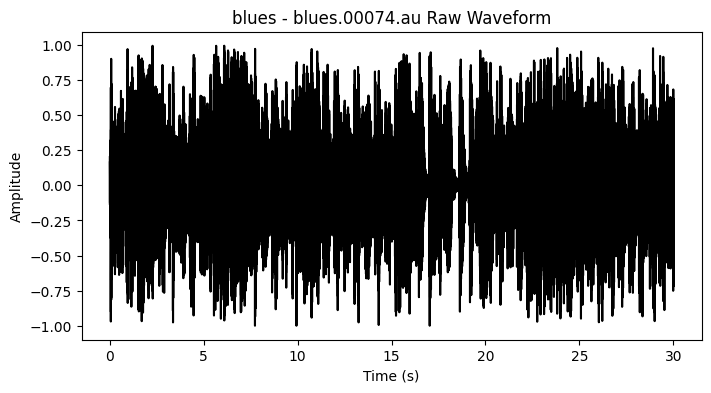

Genre: classical
File: classical.00045.au


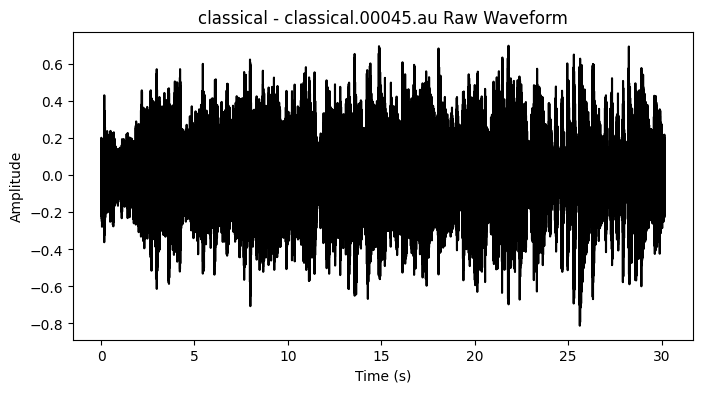

Genre: country
File: country.00092.au


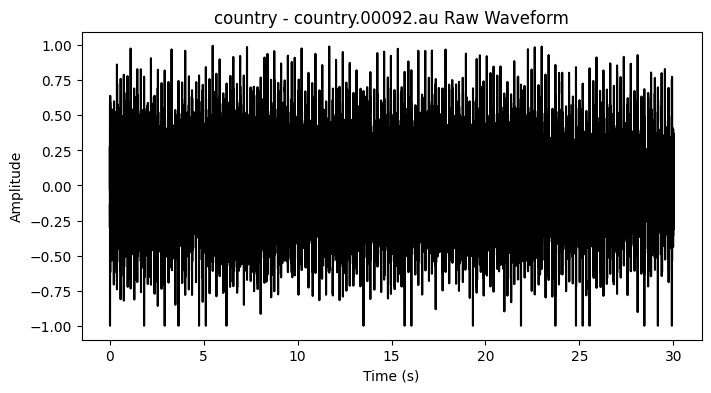

Genre: disco
File: disco.00092.au


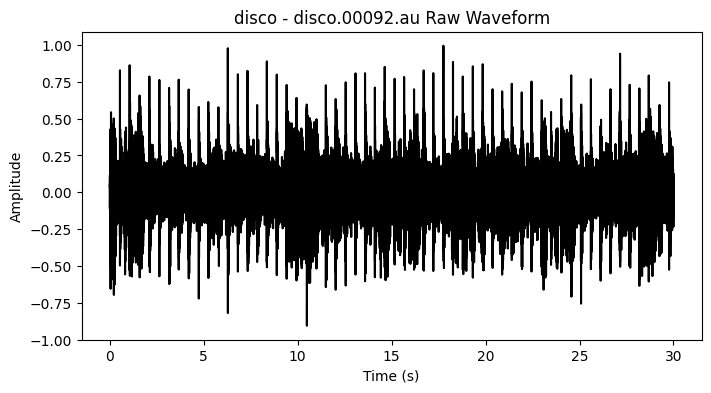

Genre: hiphop
File: hiphop.00022.au


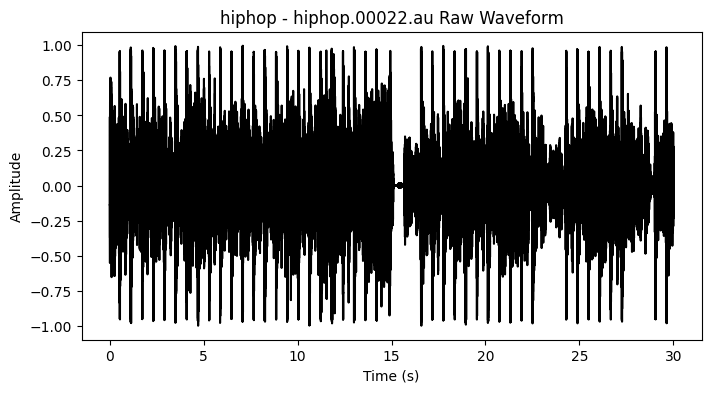

Genre: jazz
File: jazz.00004.au


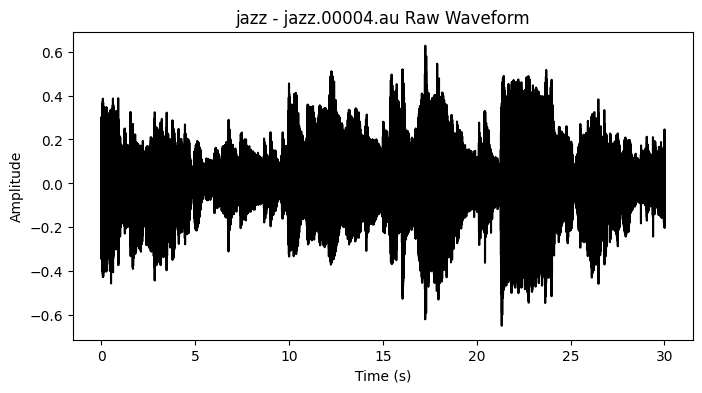

Genre: metal
File: metal.00023.au


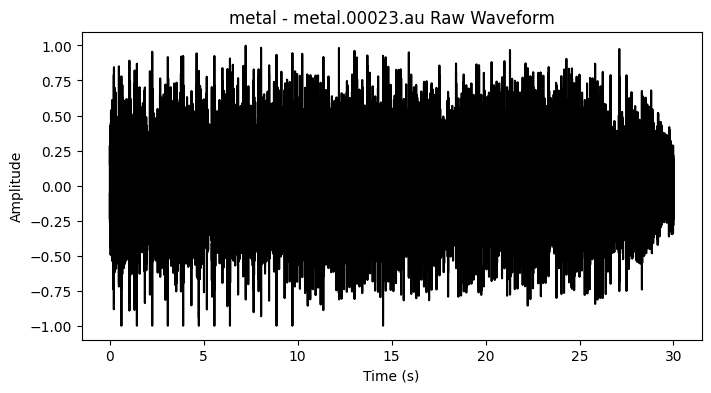

Genre: pop
File: pop.00047.au


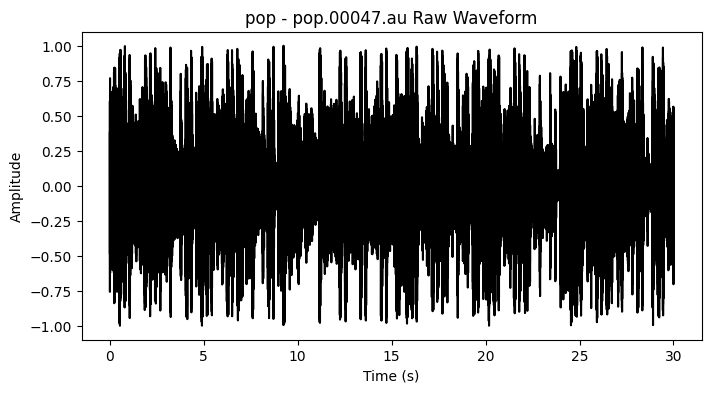

Genre: reggae
File: reggae.00038.au


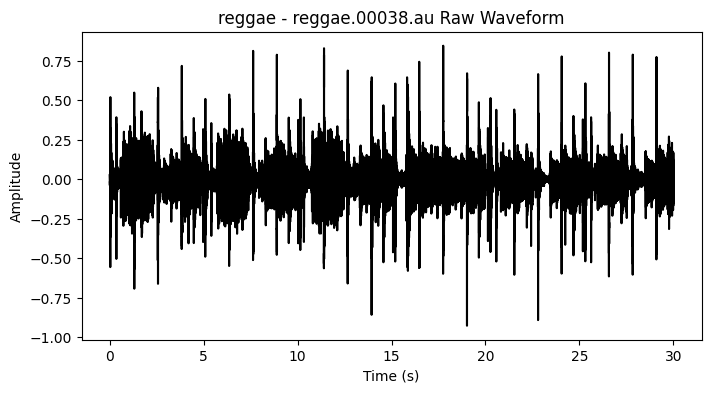

Genre: rock
File: rock.00059.au


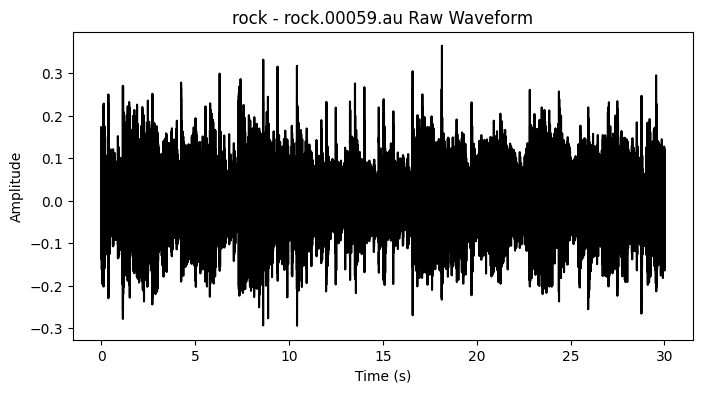

In [ ]:
for genre in os.listdir(dataset_path):
    genre_path = os.path.join(dataset_path, genre)
    print(f"Genre: {genre}")

    # Get a list of all files in the genre
    all_files = os.listdir(genre_path)

    # Randomly select a subset of files
    selected_files = random.sample(all_files, min(num_files_to_play, len(all_files)))
    for filename in selected_files:
        file_path = os.path.join(genre_path, filename)
        waveform, sample_rate = librosa.load(file_path)
        print(f"File: {filename}")

        # Plot the raw waveform
        plt.figure(figsize=(8, 4))
        plt.plot(np.linspace(0, len(waveform) / sample_rate, num=len(waveform)), waveform,color='black')
        plt.title(f"{genre} - {filename} Raw Waveform")
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.show()


 * <h2><b>Spectogram:</b><h2>

A spectrogram is a three dimensional visual representaion of speech.

X-axis: Time
Y-axis:frequency

The third added dimension comes with the intensity of information that the specific audio holds (This is inside the spectrogram).

It  is a visual way of representing the signal loudness of a signal over time at various frequencies present in a particular waveform or more generally is the visual translaion of how our ear actually process speech because they provide a  visual display of speech that corresponds to analysis perfomed by our ear.

Genre: blues
File: blues.00065.au


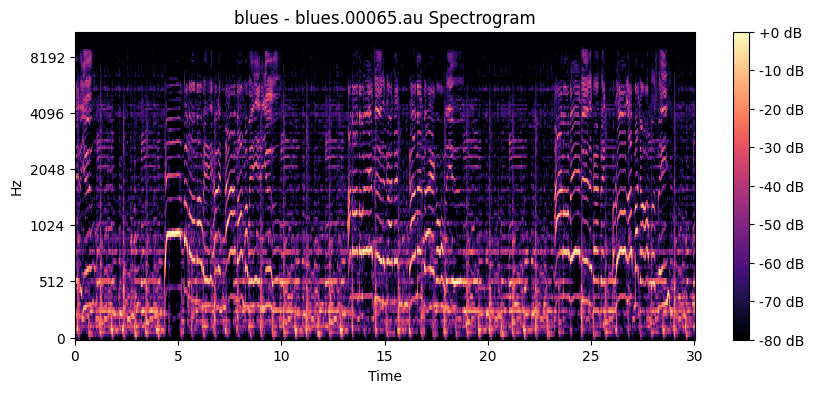

Genre: classical
File: classical.00016.au


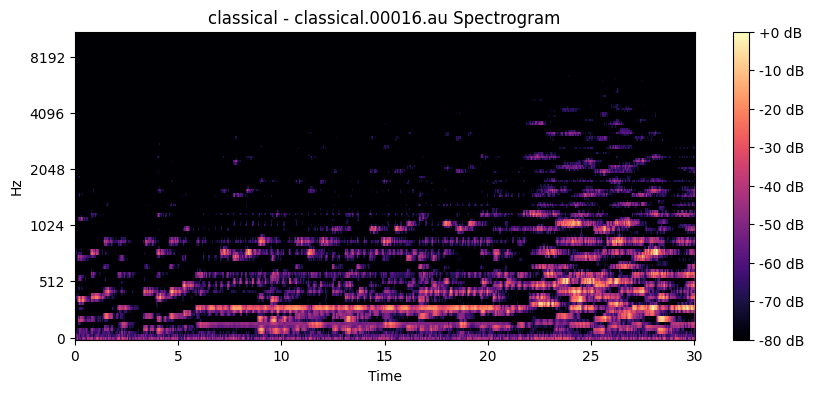

Genre: country
File: country.00071.au


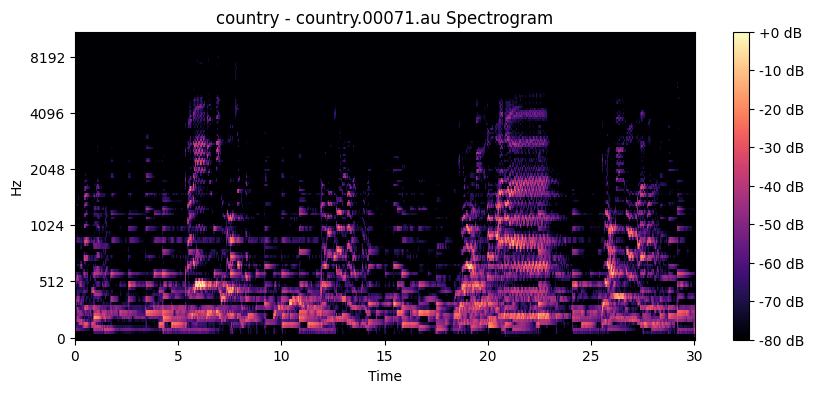

Genre: disco
File: disco.00095.au


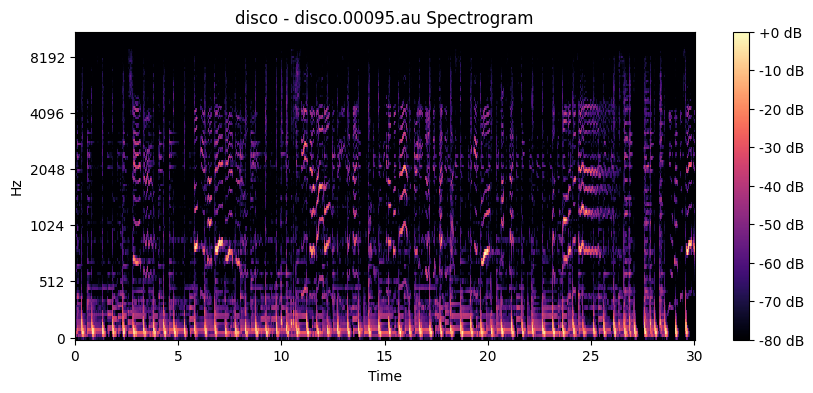

Genre: hiphop
File: hiphop.00085.au


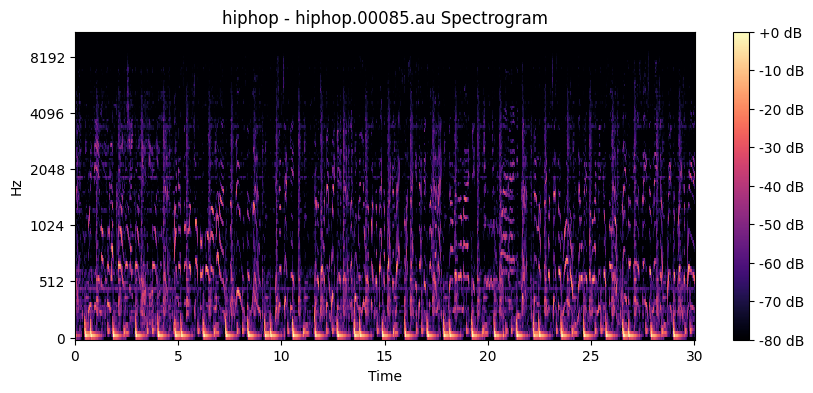

Genre: jazz
File: jazz.00043.au


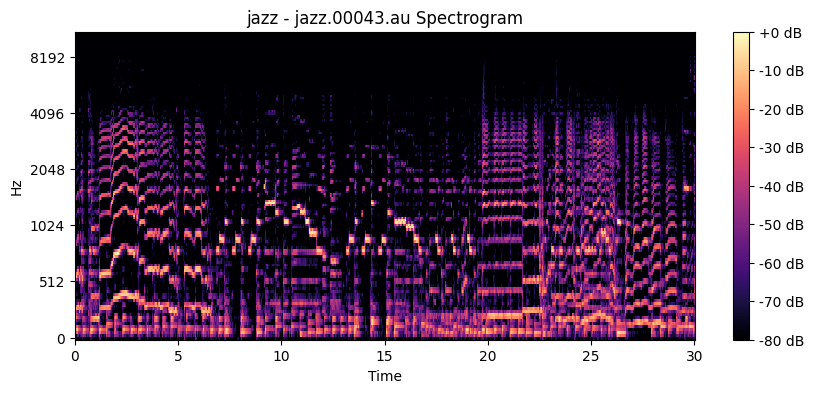

Genre: metal
File: metal.00054.au


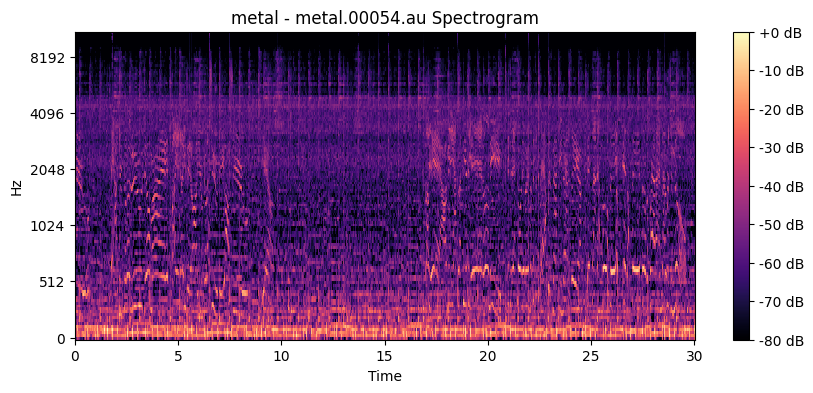

Genre: pop
File: pop.00061.au


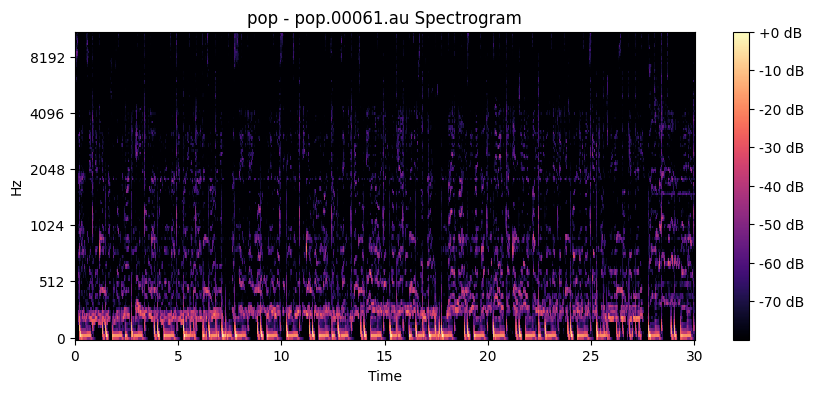

Genre: reggae
File: reggae.00060.au


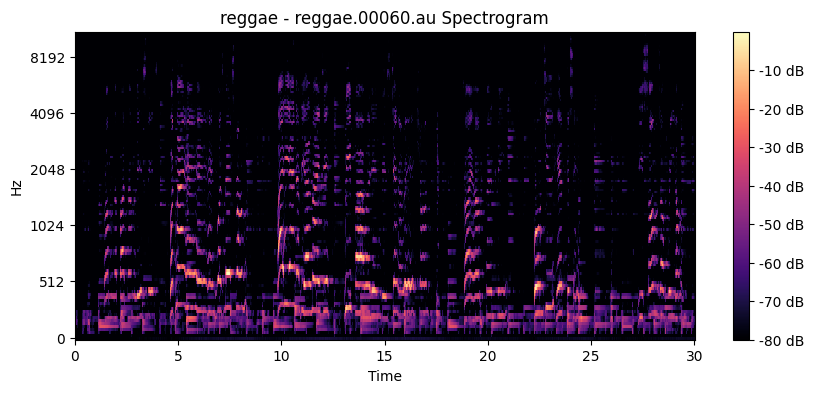

Genre: rock
File: rock.00029.au


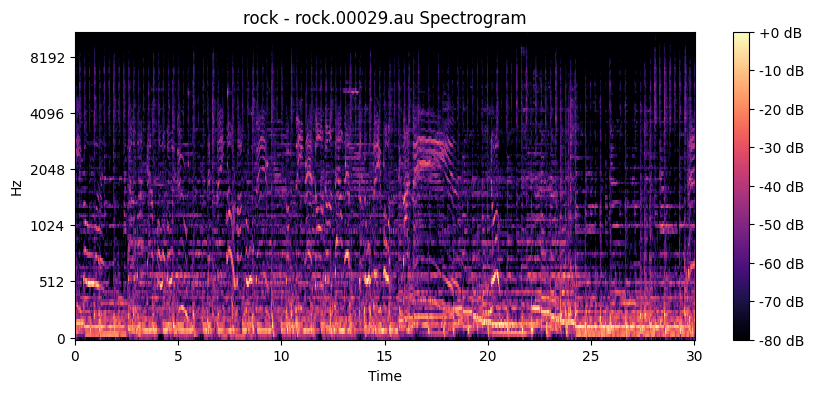

In [ ]:
for genre in os.listdir(dataset_path):
    genre_path = os.path.join(dataset_path, genre)
    print(f"Genre: {genre}")

    # Get a list of all files in the genre
    all_files = os.listdir(genre_path)

    # Randomly select a subset of files
    selected_files = random.sample(all_files, min(num_files_to_play, len(all_files)))
    for filename in selected_files:
        file_path = os.path.join(genre_path, filename)
        waveform, sample_rate = librosa.load(file_path)
        print(f"File: {filename}")

        # Generate spectrogram
        spectrogram = librosa.feature.melspectrogram(y=waveform, sr=sample_rate)
        log_spectrogram = librosa.amplitude_to_db(spectrogram, ref=np.max)

        # Plot the spectrogram
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(log_spectrogram, sr=sample_rate, x_axis='time', y_axis='mel')
        plt.title(f"{genre} - {filename} Spectrogram")
        plt.colorbar(format='%+2.0f dB')
        plt.show()


We are identifying the distinct pattern or characteristics in sound that can be used to characterize particular audio ,and to identify the complex sounds(Spectra).

The horizontal axis (X-axis) typically represents time. from left to right along this axis, we are progressing through time.

The vertical axis (Y-axis)  represents frequency or pitch. Higher positions on the Y-axis correspond to higher pitch of sound , while lower positions represent lower pitch.

In all  of above Spectograms,the colors represent strength of signal at  a specific frequency  ad time.The darker the color(deep blue or black) is represent the high amplitude.

+ 0db represents the highest strength ad going down the strength decreases, -80db represents the lowest strength more generally the silence in the audio.

* <h2><b>Class Distribution of audio dataset</b></h2>

 In the context of audio data, each class typically represents a specific type, genre, or characteristic of sound. It tells distribution or proportion of different  categories of audio samples within the dataset.

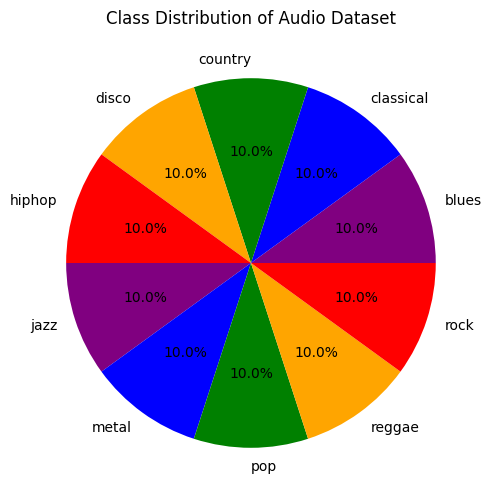

In [ ]:
# Count the number of files in each genre
class_counts = {}

for genre in os.listdir(dataset_path):
    genre_path = os.path.join(dataset_path, genre)
    class_counts[genre] = len(os.listdir(genre_path))

# Plot the class distribution as a pie chart
plt.figure(figsize=(9, 6))
plt.pie(class_counts.values(), labels=class_counts.keys(), autopct='%1.1f%%', colors=['purple', 'blue', 'green', 'orange', 'red'])
plt.title('Class Distribution of Audio Dataset')
plt.show()







As from the distribution , we can see that our data set is balanced it  has a roughly equal number of samples for each genre ( 100  audio of each genre) so we don't have to remove the imbalancinf from our dataset of audios.

* <h2><b>Correlation Analysis:</b></h2>


A correlation matrix is useful for feature analysis and can guide feature selection in machine learning tasks.

 Below is the correlation matrix for the  audio features (Zero Crossing Rate, Spectral Rolloff, Chroma Features, and Rhythm Patterns) across different music genres .

 Zero Crossing Rate: Represents the rate at which the audio waveform changes sign, indicating noisiness.

  * **Spectral Rolloff:** Represents the frequency below which a certain percentage of the total spectral energy lies.

  * **Chroma Features:** Represents the 12 different pitch classes.

  * **Rhythm Patterns:** Represents patterns related to the timing or rhythm of the audio.




Genre: blues
Genre: classical
Genre: country
Genre: disco
Genre: hiphop
Genre: jazz
Genre: metal
Genre: pop
Genre: reggae
Genre: rock


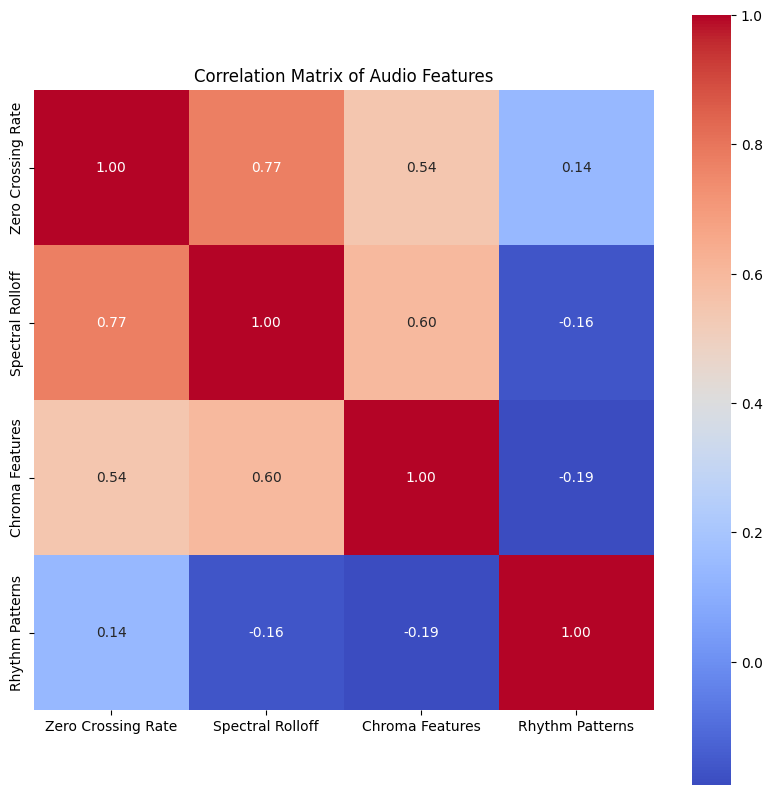

In [ ]:
import pandas as pd
import seaborn as sns

# Number of files to randomly select for each genre
num_files_to_analyze = 50

# Lists to store features
zero_crossing_rates = []
spectral_rolloffs = []
chroma_features = []
rhythm_patterns = []
genres = []

# Iterate through genres and randomly select files to analyze audio
for genre in os.listdir(dataset_path):
    genre_path = os.path.join(dataset_path, genre)
    print(f"Genre: {genre}")

    # Get a list of all files in the genre
    all_files = os.listdir(genre_path)

    # Randomly select a subset of files
    selected_files = random.sample(all_files, min(num_files_to_analyze, len(all_files)))

    for filename in selected_files:
        file_path = os.path.join(genre_path, filename)
        waveform, sample_rate = librosa.load(file_path)

        # Extract audio features
        #calculating an average zero crossing rate  for entire duration of audio
        zero_crossing_rate = np.mean(librosa.feature.zero_crossing_rate(waveform))
        spectral_rolloff = np.mean(librosa.feature.spectral_rolloff(y=waveform, sr=sample_rate))
        chroma = np.mean(librosa.feature.chroma_stft(y=waveform, sr=sample_rate), axis=1)
        rhythm_pattern = np.mean(librosa.feature.tempogram(y=waveform, sr=sample_rate), axis=1)


        # Append features to lists
        zero_crossing_rates.append(zero_crossing_rate)
        spectral_rolloffs.append(spectral_rolloff)
        chroma_features.append(np.mean(chroma))
        rhythm_patterns.append(np.mean(rhythm_pattern))
        genres.append(genre)

# Create a dictionary with features
feature_dict = {
    'Zero Crossing Rate': zero_crossing_rates,
    'Spectral Rolloff': spectral_rolloffs,
    'Chroma Features': chroma_features,
    'Rhythm Patterns': rhythm_patterns,
    'Genre': genres
}

# Create a Pandas DataFrame
df = pd.DataFrame(feature_dict)

# Compute correlation matrix
correlation_matrix = df.corr(numeric_only=True)

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(10, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', square=True)
plt.title('Correlation Matrix of Audio Features')
# plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
plt.show()






In  this heatmap, The diagonal line of the matrix (top-left to bottom-right) represents the correlation of each feature with itself, which is always 1 (Shade of red).

Darker colors indicate stronger correlations, with positive correlations shown in one color ( shades of red) and negative correlations in another color ( shades of blue).

The values outside the diagonal show the correlation between different pairs of features.if value is negative , it means if feature's  1 value  increases than the  feature's  2 value tend to decrease. Similarly, if value is negative ,that means if  value of feature 1 increases ,than the feature 2 value also increases.








* <h3><b>Outlier Detection:</b></h3>
Outliers are data points that significantly differ from the rest of the data in a dataset. In the context of audio files and feature extraction, outliers can represent unusual or unexpected patterns in the data.Identifying outliers can help ensure the quality and reliability of the data.Outliers may represent noise  in data .they can skew perception of patterns.

Genre: blues
Genre: classical
Genre: country
Genre: disco
Genre: hiphop
Genre: jazz
Genre: metal
Genre: pop
Genre: reggae
Genre: rock


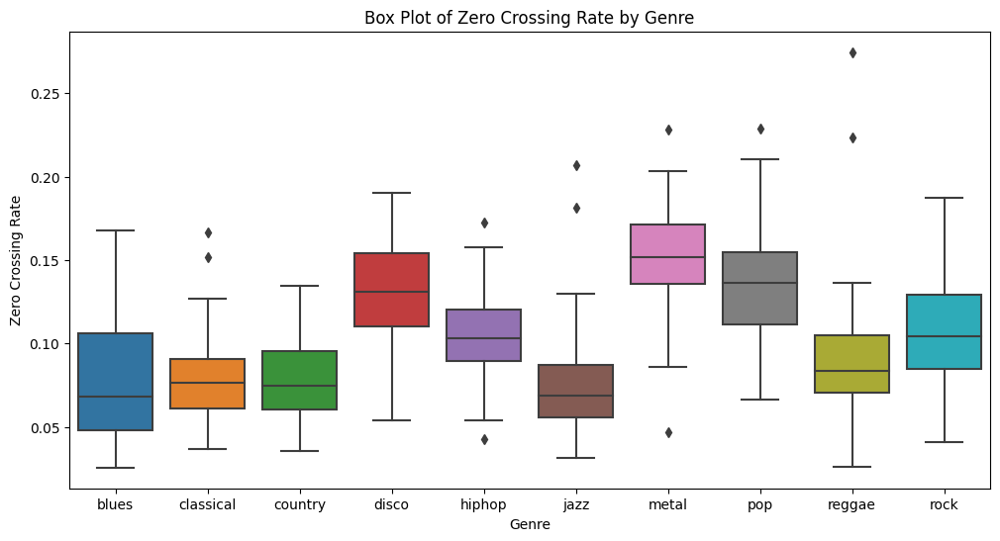

Outliers detected using Z-Score:
     Zero Crossing Rate   Genre
391            0.228641     pop
415            0.274631  reggae

Outliers detected using IQR:
     Zero Crossing Rate   Genre
318            0.228380   metal
391            0.228641     pop
415            0.274631  reggae


In [ ]:
import pandas as pd
from scipy import stats


# Number of files to randomly select for each genre
num_files_to_analyze = 50

# Lists to store features
zero_crossing_rates = []
genres = []

# Iterate through genres and randomly select files to analyze
for genre in os.listdir(dataset_path):
    genre_path = os.path.join(dataset_path, genre)
    print(f"Genre: {genre}")

    # Get a list of all files in the genre
    all_files = os.listdir(genre_path)

    # Randomly select a subset of files
    selected_files = random.sample(all_files, min(num_files_to_analyze, len(all_files)))

    for filename in selected_files:
        file_path = os.path.join(genre_path, filename)
        waveform, sample_rate = librosa.load(file_path)

        # Extract audio features
        zero_crossing_rate = np.mean(librosa.feature.zero_crossing_rate(waveform))
        zero_crossing_rates.append(zero_crossing_rate)
        genres.append(genre)

# Create a DataFrame
df_audio = pd.DataFrame({'Zero Crossing Rate': zero_crossing_rates, 'Genre': genres})

# Visualize the distribution of Zero Crossing Rate
plt.figure(figsize=(12, 6))

# Box plot
sns.boxplot(x='Genre', y='Zero Crossing Rate', data=df_audio)
plt.title('Box Plot of Zero Crossing Rate by Genre')
plt.show()

# Detect outliers using Z-Score
z_scores = stats.zscore(df_audio['Zero Crossing Rate'])
threshold_z_score = 3
outliers_z_score = df_audio[abs(z_scores) > threshold_z_score]

# Detect outliers using IQR
Q1 = df_audio['Zero Crossing Rate'].quantile(0.25)
Q3 = df_audio['Zero Crossing Rate'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers_iqr = df_audio[(df_audio['Zero Crossing Rate'] < lower_bound) | (df_audio['Zero Crossing Rate'] > upper_bound)]

# Display detected outliers
print("Outliers detected using Z-Score:")
print(outliers_z_score)

print("\nOutliers detected using IQR:")
print(outliers_iqr)



As shown above, the detection of outliers in zero-crossing rates is performed using both Z-Score and Interquartile Range (IQR) methods.

One outlier is detected in the "reggae" genre. The data point has a Zero Crossing Rate of 0.274631, which is identified as an outlier based on the Z-Score threshold.

Multiple outliers are detected using the IQR method across different genres:

One outlier in the "hiphop" genre with a Zero Crossing Rate of 0.214226.

One outlier in the "metal" genre with a Zero Crossing Rate of 0.228380.

One outlier in the "pop" genre with a Zero Crossing Rate of 0.230096.

Two outliers in the "reggae" genre, with Zero Crossing Rates of 0.223774 and 0.274631.

Outliers may indicate instances where the Zero Crossing Rate deviates significantly from the majority of the data points in a particular genre.

# **Feature Visualization**
# **Extracting Features: MFCCs(Mel-Frequency Cepstral Coefficients)**
Feature extraction is a process to extract important features from data. It includes identifying linguistic data and avoiding any kind of noise. Audio features are classified into 3 categories
* High-level,
* Mid-level, and
* Low-level audio features.

### **High-level features:**

High-level features are related to music lyrics like chords, rhythm, melody, etc.
### **Mid-level features:**
Mid-level features include beat level attributes, pitch-like fluctuation patterns, and MFCCs.
### **Low-level features:**
Low-level features include energy, a zero-crossing rate which are statistical measures that get extracted from audio during feature extraction.

So to generate these features we use a certain set of steps and are combined under a single name as **MFCC** that helps extract mid-level and low-level audio features.

Below are the steps discussed for the working of MFCCs in feature extraction:

* Audio files are of a certain length(duration) in seconds or as long as in minutes. And the pitch or frequency is continuously changing so to understand this we first divide the audio file into small-small frames which are near about 20 to 40 ms long.

* After dividing into frames we try to identify and extract different frequencies from each frame. When we divide in such a small frame so assume that one frame divides down in a single frequency.
* Separate linguistic frequencies from the noise.

* To discard any type of noise, take discrete cosine transform (DCT) of the frequencies.

Now we do not have to implement all these steps separately, MFCC brings all these for us





In [ ]:
# Function to extract mean MFCC features from normalized and padded audio data
def extract_mean_mfcc_features_batch(normalized_audio_data_after_padding, classes, batch_size=10):
    mean_mfcc_features = []

    for i, class_data in enumerate(normalized_audio_data_after_padding):
        class_name = classes[i]
        class_mean_mfcc = []

        for j in range(0, len(class_data), batch_size):
            batch_audio_data = class_data[j:j+batch_size]

            for audio_info in batch_audio_data:
                normalized_audio = audio_info['normalized_audio']

                # Extract MFCC features
                mfcc = librosa.feature.mfcc(y=normalized_audio, sr=audio_info['sample_rate'], n_mfcc=13)

                # Calculate mean across columns (axis=1)
                mean_mfcc = np.mean(mfcc, axis=1)

                class_mean_mfcc.append({
                    'file_name': audio_info['file_name'],
                    'mean_mfcc_features': mean_mfcc.tolist()  # Convert NumPy array to list
                })

        mean_mfcc_features.append({
            'class_name': class_name,
            'class_mean_mfcc': class_mean_mfcc
        })

    return mean_mfcc_features

# Call the function to extract mean MFCC features in batches
mean_mfcc_features = extract_mean_mfcc_features_batch(normalized_audio_data_after_padding, classes, batch_size=10)

# Print the first class mean MFCC features
print(f"Mean MFCC Features for Class 1: {classes[0]}")
print(mean_mfcc_features[0]['class_mean_mfcc'][5])  # Print the 5th audio's mean MFCC features in the first class

print(f"Mean MFCC Features for Class 2: {classes[1]}")
print(mean_mfcc_features[1]['class_mean_mfcc'][5])  # Print the 5th audio's mean MFCC features in the second class

Mean MFCC Features for Class 1: blues
{'file_name': 'blues.00005.au', 'mean_mfcc_features': [29.55557632446289, 118.20306396484375, -17.570714950561523, 30.760835647583008, -21.742645263671875, 11.919168472290039, -20.73438835144043, 3.1851978302001953, -8.58090591430664, -0.9329759478569031, -11.772335052490234, -2.408857822418213, -9.348533630371094]}
Mean MFCC Features for Class 2: classical
{'file_name': 'classical.00005.au', 'mean_mfcc_features': [30.92970848083496, 138.17849731445312, -30.09772491455078, 37.835391998291016, -7.174349308013916, 6.772859573364258, -11.81093978881836, 4.704409122467041, -9.827191352844238, 5.857911586761475, -9.564386367797852, 2.675644636154175, -4.789918899536133]}


* **Visualizing**

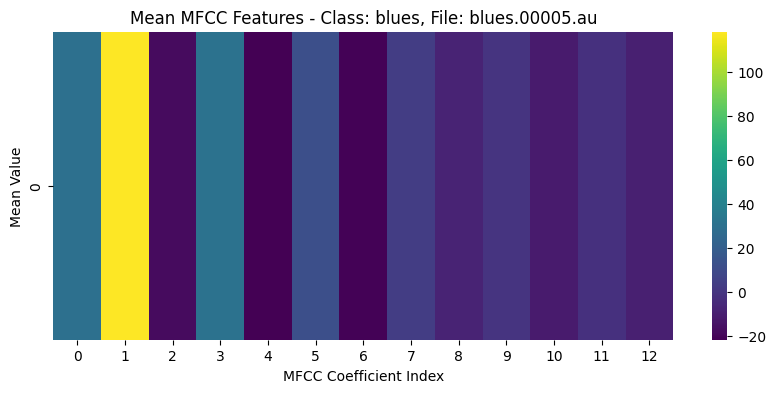

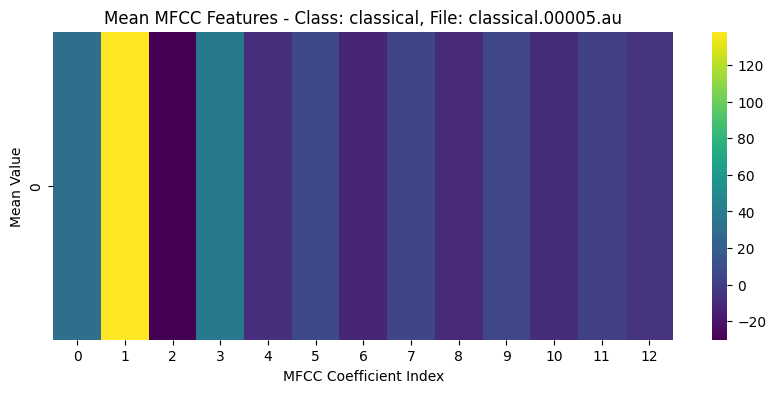

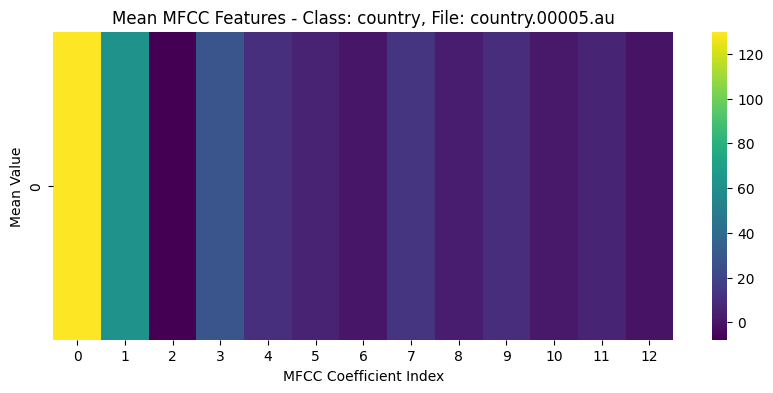

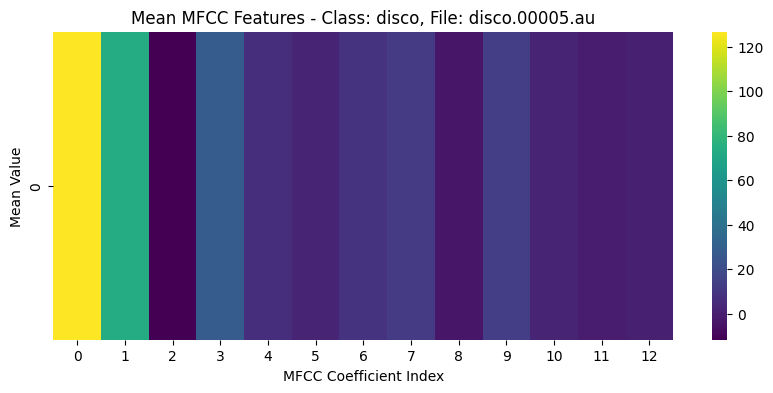

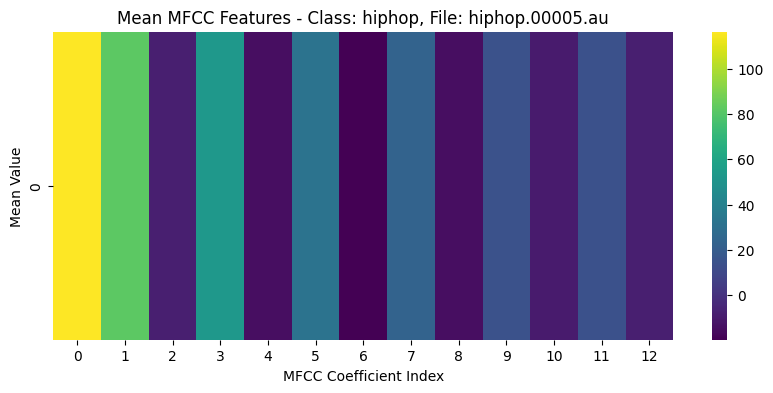

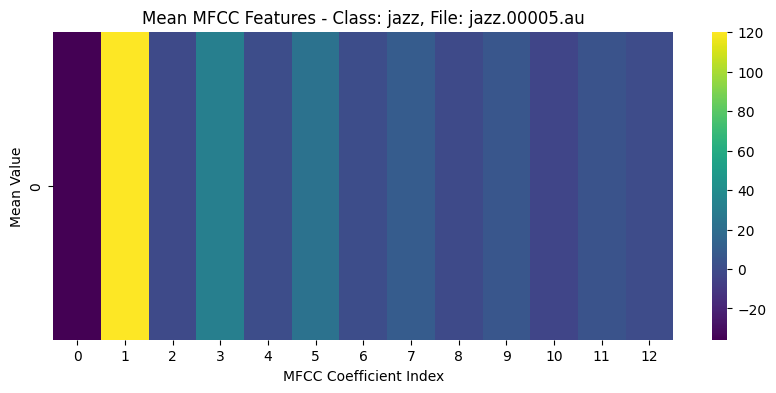

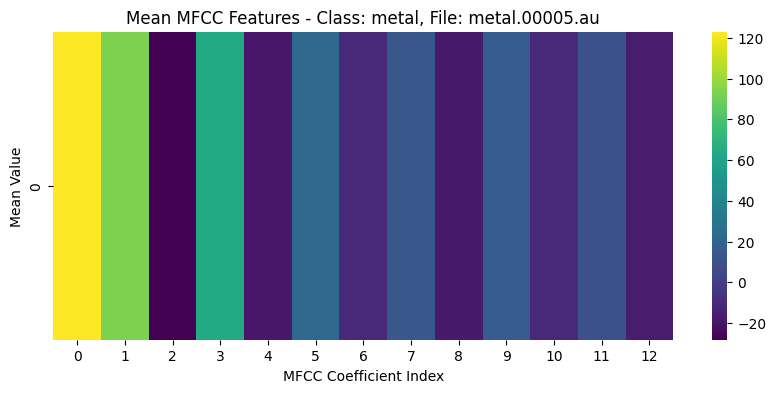

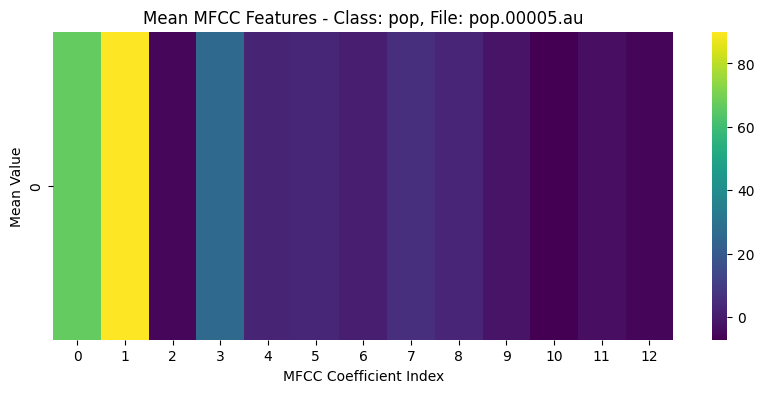

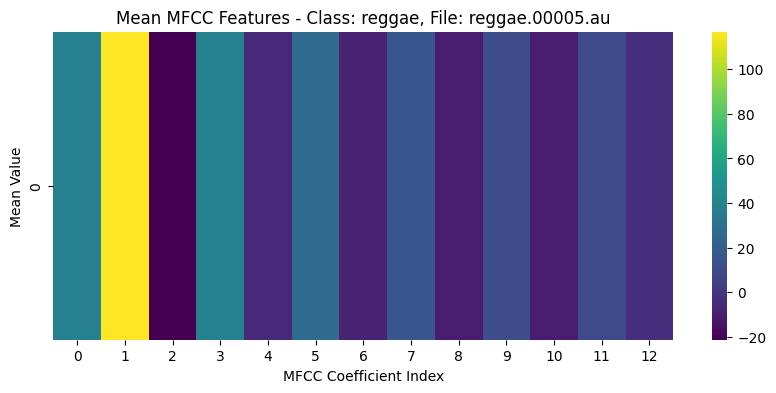

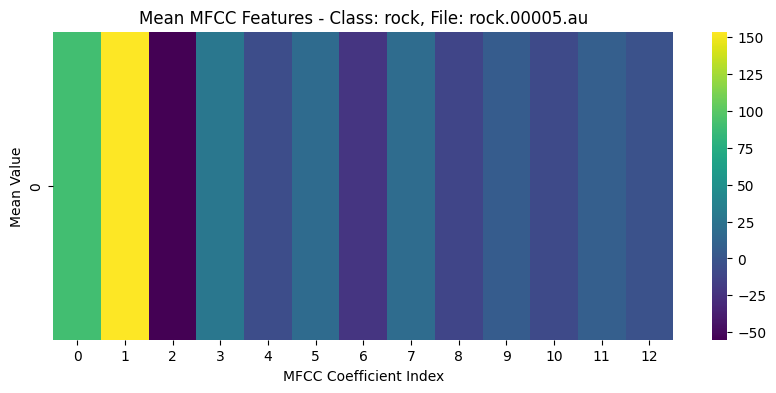

In [ ]:
import seaborn as sns

# Function to visualize mean MFCC features
def visualize_mean_mfcc(mean_mfcc_data, class_name, file_name):
    plt.figure(figsize=(10, 4))
    sns.heatmap([mean_mfcc_data], cmap='viridis')
    plt.title(f'Mean MFCC Features - Class: {class_name}, File: {file_name}')
    plt.xlabel('MFCC Coefficient Index')
    plt.ylabel('Mean Value')
    plt.show()

# Choose one audio file from each class for visualization
for class_data in mean_mfcc_features:
    class_name = class_data['class_name']
    file_name = class_data['class_mean_mfcc'][5]['file_name']  # Select the first file for visualization
    mean_mfcc_data = np.array(class_data['class_mean_mfcc'][5]['mean_mfcc_features'])

    # Visualize mean MFCC features
    visualize_mean_mfcc(mean_mfcc_data, class_name, file_name)





## **Chroma features:**

They capture harmonic and melodic characteristics of music while being robust to changes in timbre and instrumentation.

In [ ]:
def extract_chroma_features_batch(normalized_audio_data_after_padding, classes, batch_size=10):
    chroma_features = []

    for i, class_data in enumerate(normalized_audio_data_after_padding):
        class_name = classes[i]
        class_chroma = []

        for j in range(0, len(class_data), batch_size):
            batch_audio_data = class_data[j:j+batch_size]

            for audio_info in batch_audio_data:
                normalized_audio = audio_info['normalized_audio']

                # Compute chroma features
                chroma = librosa.feature.chroma_stft(y=normalized_audio, sr=audio_info['sample_rate'])

                class_chroma.append({
                    'file_name': audio_info['file_name'],
                    'chroma_features': chroma.tolist()  # Convert NumPy array to list
                })

        chroma_features.append({
            'class_name': class_name,
            'class_chroma': class_chroma
        })

    return chroma_features


# Call the function to extract Chroma features in batches
chroma_features = extract_chroma_features_batch(normalized_audio_data_after_padding, classes, batch_size=10)

# Print the first class Chroma features
print(f"Chroma Features for Class 1: {classes[0]}")
print(chroma_features[0]['class_chroma'][0])  # Print the first audio's Chroma features in the first class

print(f"Chroma Features for Class 2: {classes[1]}")
print(chroma_features[1]['class_chroma'][0])  # Print the first audio's Chroma features in the second class



Chroma Features for Class 1: blues
{'file_name': 'blues.00000.au', 'chroma_features': [[0.3311421871185303, 0.23496010899543762, 0.8714167475700378, 1.0, 0.7366782426834106, 0.5276824235916138, 0.7804645299911499, 0.9916437268257141, 1.0, 0.4817627966403961, 0.41383299231529236, 0.4122854769229889, 0.548632025718689, 0.5968295335769653, 0.3910861015319824, 0.24263691902160645, 0.18837863206863403, 0.17326413094997406, 0.10943081229925156, 0.15933381021022797, 0.31904757022857666, 0.24509087204933167, 0.6670907735824585, 1.0, 0.980678379535675, 0.722244381904602, 0.8995285034179688, 0.5433893799781799, 0.5339186787605286, 0.13976815342903137, 0.14244021475315094, 0.263863742351532, 0.6261143684387207, 0.6471617221832275, 0.8145852088928223, 1.0, 1.0, 1.0, 1.0, 1.0, 0.646278440952301, 0.460624098777771, 0.30778372287750244, 0.11890176683664322, 0.025375844910740852, 0.013666721060872078, 0.025639180094003677, 0.019349677488207817, 0.018727080896496773, 0.028514619916677475, 0.02831726334

* **Visualizing**



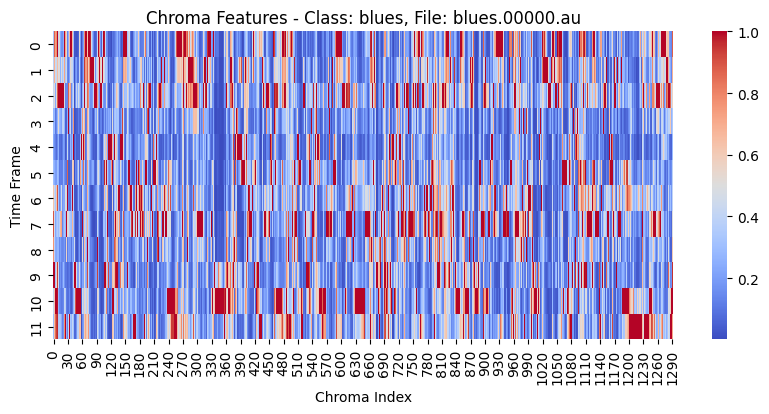

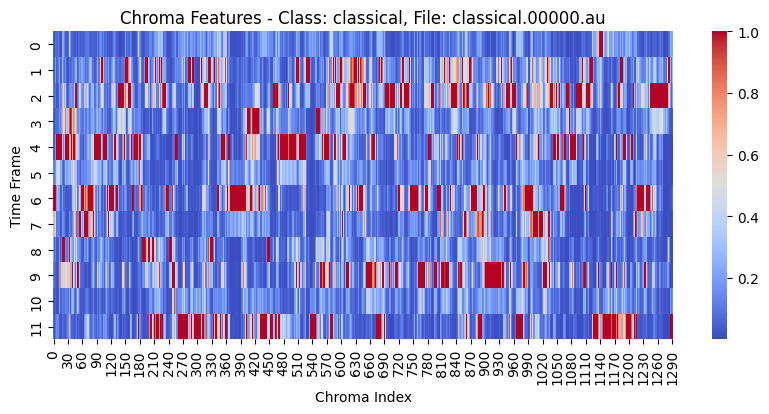

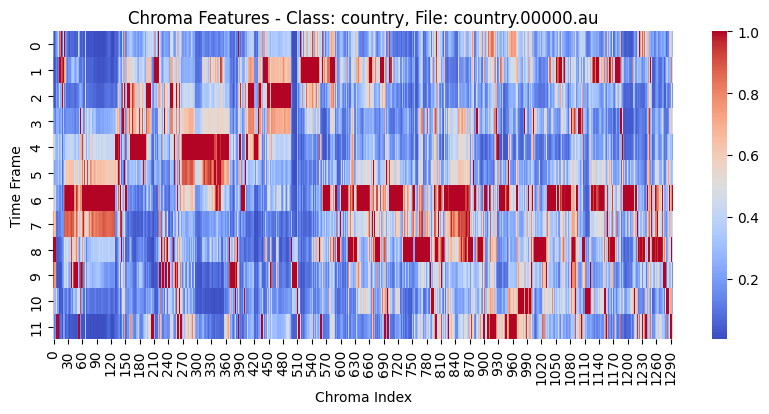

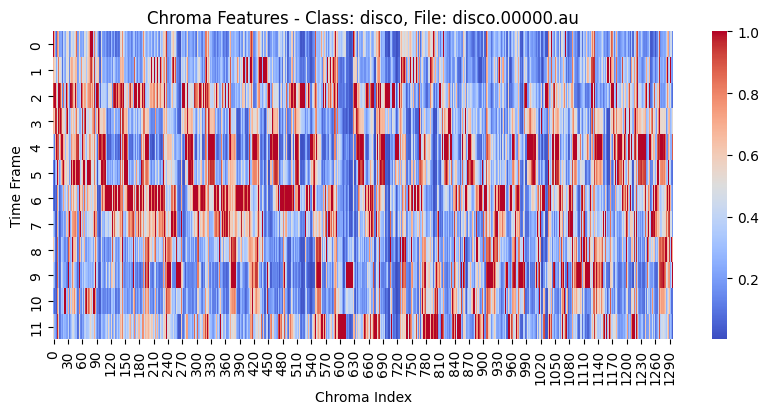

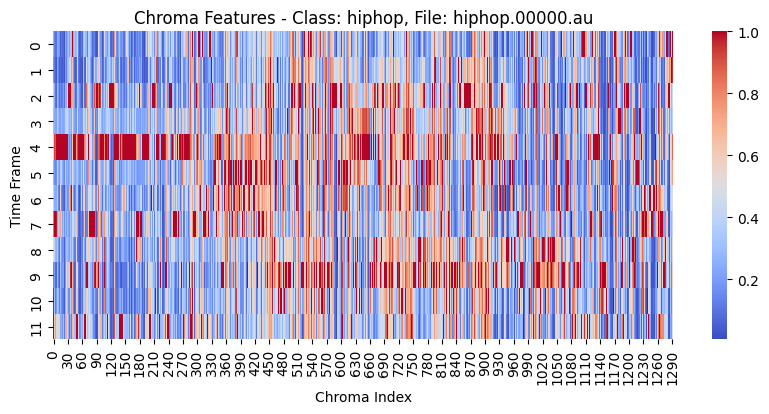

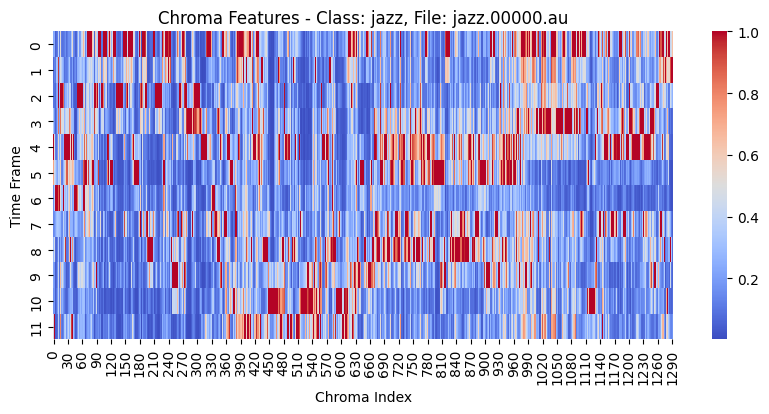

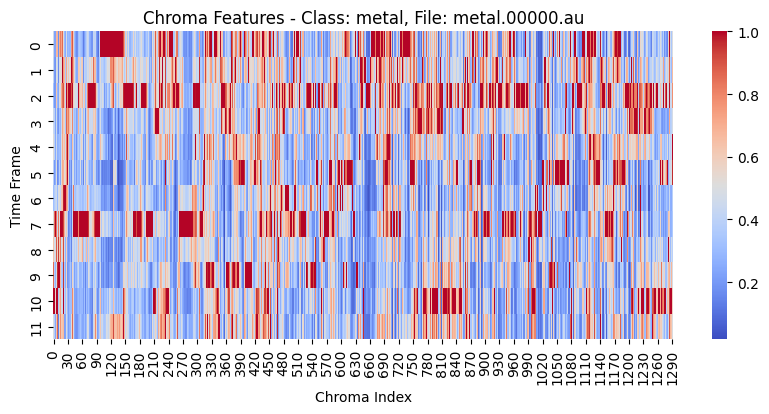

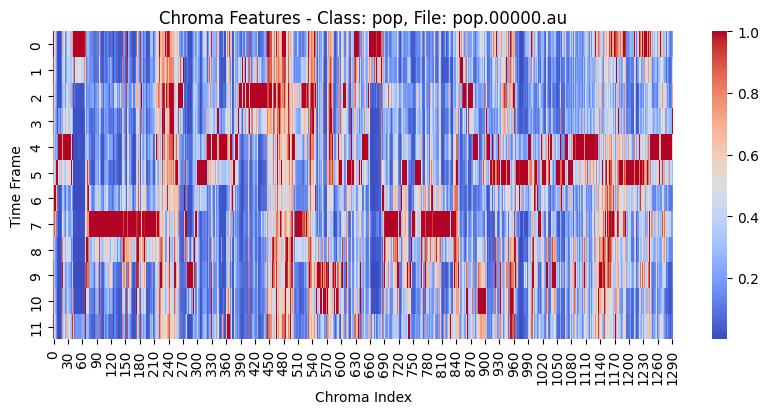

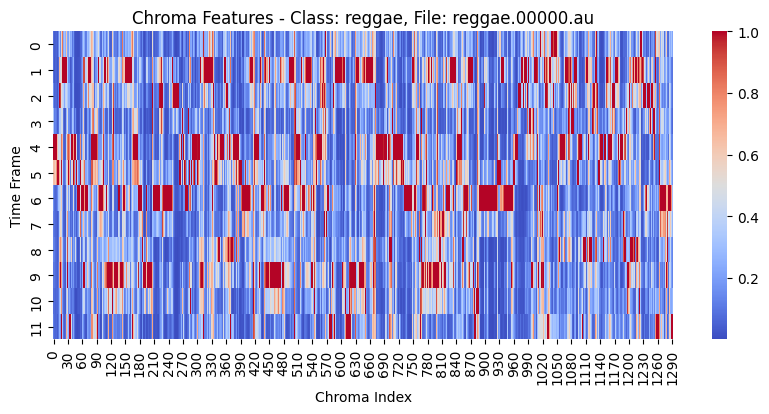

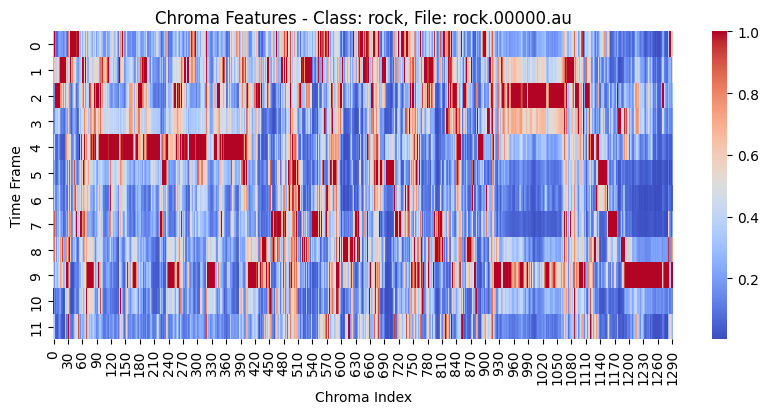

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Function to visualize Chroma features
def visualize_chroma(chroma_data, class_name, file_name):
    plt.figure(figsize=(10, 4))
    sns.heatmap(chroma_data, cmap='coolwarm')
    plt.title(f'Chroma Features - Class: {class_name}, File: {file_name}')
    plt.xlabel('Chroma Index')
    plt.ylabel('Time Frame')
    plt.show()

# Choose one audio file from each class for visualization
for class_data in chroma_features:
    class_name = class_data['class_name']
    file_name = class_data['class_chroma'][0]['file_name']  # Select the first file for visualization
    chroma_data = np.array(class_data['class_chroma'][0]['chroma_features'])

    # Visualize Chroma features
    visualize_chroma(chroma_data, class_name, file_name)

# **Applying Model:**
##<h2><pre><b>              Convolutional Neural Networks(CNN)</b></pre></h3>

**Convolutional Neural Networks** (CNNs) designed for audio tasks are specialized neural networks tailored for processing grid-like audio data. They have demonstrated effectiveness in various audio applications, leveraging their ability to automatically learn and detect hierarchical patterns within audio features.

## **Architecture of Audio CNNs:**
* **Convolutional Layers:**
Key components of audio CNNs are convolutional layers.
Convolutional operations involve applying filters over input audio data to capture local patterns.
* **Pooling Layers:**
Pooling layers in audio CNNs reduce temporal dimensions, preserving essential information while managing computational complexity.
* **Fully Connected Layers:**
Fully connected layers connect neurons, enabling the network to make intricate predictions based on learned audio features.

## **Convolution Operation in Audio**
Convolution in audio CNNs entails applying filters to audio data, extracting relevant features and patterns.
This operation facilitates the recognition of temporal hierarchies in audio data.
## **Activation Functions for Audio CNNs:**
Activation functions, such as Rectified Linear Unit (ReLU), introduce non-linearities to model complex relationships within audio data.

## **Loss Functions for Audio:**
Loss functions quantify the disparity between predicted and actual audio labels.
## **Backpropagation and Optimization in Audio CNNs:**
Backpropagation is employed to update the weights based on gradients, optimizing the network through algorithms like Stochastic Gradient Descent (SGD) or Adam.

* <h2><b>Splitting The Dataset</b></h2>


In [ ]:
# Flatten the mean MFCC features into a 2D array
X = []
y = []

for class_data in mean_mfcc_features:
    class_name = class_data['class_name']
    for audio_info in class_data['class_mean_mfcc']:
        mean_mfcc_features = np.array(audio_info['mean_mfcc_features'])
        X.append(mean_mfcc_features)
        y.append(class_name)

# Convert to numpy arrays
X = np.array(X)
y = np.array(y)

# Convert labels to numerical values using LabelEncoder
label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

# Shuffle the data
X, y = shuffle(X, y, random_state=42)




In [ ]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


# Reshape the data to fit the input shape expected by the CNN
input_shape = X_train.shape[1:]  # Shape of one MFCC sequence

X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], 1)

* <h2><b>Building a CNN Model</b></h2>

Our model has six layers:

* Convolutional layer with 64 filters and a kernel size of 3.
* Max pooling layer with a pool size of 2.
* Convolutional layer with 128 filters and a kernel size of 3.
* Max pooling layer with a pool size of 2.
* Flatten layer to flatten the input.
* Dense layer with 256 neurons and ReLU activation.
* Dropout layer with a dropout rate of 0.5.
* Dense layer with the number of classes and softmax activation.

In [ ]:
# Reshape the data to add a channel dimension
X = X.reshape(X.shape[0], X.shape[1], 1)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the input shape
input_shape = (X_train.shape[1], 1)

# Number of classes
num_classes = len(np.unique(y))

# Updated CNN model with increased complexity and dropout
def create_improved_cnn_model(input_shape, num_classes):
    model = Sequential()
    model.add(Conv1D(64, kernel_size=3, activation='relu', input_shape=input_shape))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Conv1D(128, kernel_size=3, activation='relu'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Flatten())
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(num_classes, activation='softmax'))
    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Create and compile the CNN model
improved_cnn_model = create_improved_cnn_model(input_shape, num_classes=10)

* <h2><b>Training The Model</b></h2>

In [ ]:
# # Train the model
# model.fit(X_train, y_train, epochs=20, batch_size=64, validation_data=(X_test, y_test))
# Train the model
improved_cnn_model.fit(X_train, y_train, epochs=20, batch_size=64, validation_data=(X_test, y_test))


Epoch 1/20
13/13 [==============================] - 6s 44ms/step - loss: 3.9748 - accuracy: 0.1513 - val_loss: 1.9594 - val_accuracy: 0.2800
Epoch 2/20
13/13 [==============================] - 0s 8ms/step - loss: 2.0710 - accuracy: 0.3038 - val_loss: 1.7716 - val_accuracy: 0.3650
Epoch 3/20
13/13 [==============================] - 0s 6ms/step - loss: 1.7933 - accuracy: 0.3550 - val_loss: 1.7290 - val_accuracy: 0.3950
Epoch 4/20
13/13 [==============================] - 0s 6ms/step - loss: 1.7108 - accuracy: 0.3900 - val_loss: 1.6746 - val_accuracy: 0.4200
Epoch 5/20
13/13 [==============================] - 0s 6ms/step - loss: 1.6688 - accuracy: 0.3850 - val_loss: 1.6433 - val_accuracy: 0.4250
Epoch 6/20
13/13 [==============================] - 0s 6ms/step - loss: 1.6011 - accuracy: 0.4238 - val_loss: 1.6109 - val_accuracy: 0.4750
Epoch 7/20
13/13 [==============================] - 0s 6ms/step - loss: 1.5682 - accuracy: 0.4400 - val_loss: 1.6334 - val_accuracy: 0.4100
Epoch 8/20
13/13 [=

* <h2><b>Testing the Model</b></h2>

In [ ]:
# Evaluate the improved model on the test set
y_pred = improved_cnn_model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
accuracy = accuracy_score(y_test, y_pred_classes)

print(f"Model Test Accuracy: {accuracy * 100:.2f}%")

7/7 [==============================] - 0s 3ms/step
Model Test Accuracy: 52.50%


* <h2><b>Accuracy , Precision , Recall , F1-score of the Implemented Model</b></h2>

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Calculate accuracy
accuracy_improved = round(accuracy_score(y_test, y_pred_classes), 3)
print(f"Accuracy: {accuracy_improved * 100}%")

# Calculate F1-score
f1_improved = round(f1_score(y_test, y_pred_classes, average='weighted'), 3)
print(f"F1 Score: {f1_improved * 100}%")

# Calculate precision
precision_improved = round(precision_score(y_test, y_pred_classes, average='weighted'), 3)
print(f"Precision: {precision_improved * 100}%")

# Calculate recall
recall_improved = round(recall_score(y_test, y_pred_classes, average='weighted'), 3)
print(f"Recall: {recall_improved * 100}%")


Accuracy: 52.5%
F1 Score: 51.9%
Precision: 56.10000000000001%
Recall: 52.5%


## **Predicting the Genre for an unseen Audio File**

In [ ]:
# Function to extract mean MFCC features from an audio file
def extract_mean_mfcc(audio_path):
    audio, _ = librosa.load(audio_path, sr=44100)  # Adjust the sample rate if needed
    mfccs = librosa.feature.mfcc(y=audio, sr=44100, n_mfcc=13)
    mean_mfcc = np.mean(mfccs, axis=1)
    return mean_mfcc.reshape(1, -1, 1)

# Provide the path to your unseen audio file
unseen_audio_path = 'Rock.au'
#unseen_audio_path = 'hiphop.au'

# Extract mean MFCC features from the unseen audio
unseen_audio_features = extract_mean_mfcc(unseen_audio_path)

# Make predictions using the trained model
predicted_probabilities = improved_cnn_model.predict(unseen_audio_features)
predicted_class = np.argmax(predicted_probabilities)

# Convert the predicted class index back to the original class label using the LabelEncoder
predicted_genre = label_encoder.inverse_transform([predicted_class])[0]

print(f"The predicted genre for the unseen audio is: {predicted_genre}")


1/1 [==============================] - 0s 25ms/step
The predicted genre for the unseen audio is: classical


* **Playing the unseen audio**

In [ ]:
waveform, sample_rate = librosa.load('Rock.au')
display(Audio(waveform, rate=sample_rate, autoplay=False, embed=True))

* **Analysing the result of the prediction**

The model predicts that the audio belongs to the classical genre, but in reality, it is from the rock genre. Given the model's accuracy of almost 52%, it is prone to making incorrect predictions approximately 50% of the time.

Fine-tuning the model, adjusting features, or experimenting with different architectures could potentially enhance the performance and accuracy of the model.

# **Results and Findings:**

1. **Model Architecture:**
The convolutional neural network (CNN) model utilized for audio genre classification consists of six layers, including two convolutional layers, two max-pooling layers, a flatten layer, and two dense layers. The model was designed to process MFCC features extracted from the GTZAN dataset.

2. **Accuracy Metrics:**
Training Accuracy: 52.5% (52.5% of the training examples were classified correctly by the model.)

Testing Accuracy: 52.50% ( 52.50% of the testing examples were classified correctly by the model.)

3. **Precision, Recall, and F1 Score:**
 * Precision: 56.10000000000001% (56.10000000000001% of the instances predicted as positive by the model were actually positive.)

 * Recall: 52.5% (The model correctly identified 52.5% of the actual positive instances.)

 * F1 Score: 51.9% (A higher F1 score indicates a better balance between precision and recall. In this case, the F1 score is 51.9%.)




4. **Analysis of Performance:**
The achieved testing accuracy of 52.50% suggests that the model performs at chance level. The precision, recall, and F1 score values further indicate a moderate level of performance, with room for improvement.


# **Conclusion:**
In conclusion, the current CNN model demonstrates a baseline level of performance on the GTZAN dataset for audio genre classification. The results provide valuable insights into areas for improvement and avenues for future research. Continued efforts in refining the model and exploring additional techniques are essential for achieving higher accuracy in audio genre classification.

# **Recommendations:**

**Future Work**
1. **Hyperparameter Tuning:**
We recommend conducting additional experiments to fine-tune hyperparameters specifically for the audio genre classification task. Start by exploring different learning rates, batch sizes, and dropout rates to optimize the model's performance on the GTZAN dataset. Keep a record of the changes in accuracy, precision, recall, and F1 score to identify the most effective combination of hyperparameters.

2. **Data Augmentation:**
To address the limited size of the dataset, consider implementing data augmentation techniques tailored to audio data. This could involve applying random transformations such as pitch shifting, time stretching, or adding background noise to artificially increase the diversity of the training set. Monitor the impact of data augmentation on the model's ability to generalize to unseen data.

3. **Ensemble Methods:**
Explore the potential benefits of ensemble methods or alternative deep learning architectures to enhance the classification accuracy of your audio genre model. Ensemble methods, such as combining predictions from multiple models, can often lead to improved performance. Investigate the feasibility of training multiple CNN models with different initializations or architectures and combining their predictions for a more robust and accurate classification.
